## ContrastiveVI output

Prep data for embedding
- Merge lanes
- Exclude cells with no guide 
- Check potential doublets 

In [1]:

import os
import scvi
import torch
import anndata
import argparse
import pandas as pd
import numpy as np
import scanpy as sc
import rapids_singlecell as rsc 
import scipy.sparse
import mudata
import genomic_features as gf
from typing import Optional, Union, List

import matplotlib.pyplot as plt
import seaborn as sns


def _convert_oak_path(path):
        """Helper function to convert oak paths between different mount points"""
        if not os.path.exists(path):
            return path.replace('/oak/stanford/groups/pritch/', '/mnt/oak/')
        return path

/home/emmadann/miniforge3/envs/rapids_singlecell/lib/python3.11/site-packages/anndata/utils.py:435: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/emmadann/miniforge3/envs/rapids_singlecell/lib/python3.11/site-packages/anndata/utils.py:435: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/emmadann/miniforge3/envs/rapids_singlecell/lib/python3.11/site-packages/anndata/utils.py:435: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)
/home/emmadann/miniforge3/envs/rapids_singlecell/lib/python3.11/site-packages/anndata/utils.py:435: FutureWarning: Importing CSCDataset from `anndata.experimental` is deprecated. Import anndata.abc.CSCDataset instead.
  warnings.warn(msg, FutureWarning)
/home/emmadann/miniforge3/envs/rap

In [2]:
# Download and read the Core Essential and non-essential gene list (as used in GeneBayes paper)
ceg_url = "https://raw.githubusercontent.com/macarthur-lab/gene_lists/master/lists/CEGv2_subset_universe.tsv"
neg_url = 'https://raw.githubusercontent.com/macarthur-lab/gene_lists/refs/heads/master/lists/NEGv1_subset_universe.tsv'
core_essential = pd.read_csv(ceg_url, sep='\t', header=None)[0].tolist()
core_nonessential = pd.read_csv(neg_url, sep='\t', header=None)[0].tolist()


In [3]:
## Load gene sets of interest
schmidt_crispri = pd.read_excel('../../metadata/Schmidt2022_hits_Supplementary_table_2.xlsx', usecols=range(10))
schmidt_crispri_hits = schmidt_crispri[schmidt_crispri['Hit'] & (schmidt_crispri['CRISPRa_or_i'] == 'CRISPRi') & (schmidt_crispri['CD4_or_CD8'] == 'CD4')]

# Create dictionary where key is hit type and values are lists of genes
hit_type_dict = {}
for hit_type in schmidt_crispri_hits['Hit_Type'].unique():
    hit_type_dict[hit_type] = schmidt_crispri_hits[schmidt_crispri_hits['Hit_Type'] == hit_type]['Gene'].tolist()

In [4]:
import yaml
config_file = '../../metadata/experiments_config.yaml'
experiment_name = 'CRiCD4_Run1_Illumina'

with open(config_file, 'r') as f:
    config = yaml.safe_load(f)

config = config[experiment_name]
datadir = _convert_oak_path(config['datadir'])
sample_metadata_csv = _convert_oak_path(config['sample_metadata'])
sample_metadata = pd.read_csv(sample_metadata_csv, index_col=0)
sgrna_library_metadata = pd.read_csv('../../metadata/sgRNA_library_curated.csv', index_col=0)

In [5]:
# # Load saved contrastiveVI model
# model = scvi.external.ContrastiveVI.load(f'{experiment_name}.model_contrastiveVI', adata=adata)

In [6]:
# import matplotlib.pyplot as plt
# plt.plot(model.history_['elbo_train'].values[3:])
# plt.plot(model.history_['elbo_validation'].values[3:])

In [7]:
mdata_cVI = mudata.read_h5mu(f'{experiment_name}.model_contrastiveVI.h5mu')

/home/emmadann/.local/lib/python3.11/site-packages/mudata/_core/mudata.py:1531: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("var", axis=0, join_common=join_common)
/home/emmadann/.local/lib/python3.11/site-packages/mudata/_core/mudata.py:931: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(
/home/emmadann/.local/lib/python3.11/site-packages/mudata/_core/mudata.py:1429: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._up

## Overall distribution of perturbations per condition

In [59]:
high_counts = mdata_cVI['salient'].obs['perturbed_gene_name'].value_counts()
high_counts = high_counts[high_counts > 30].index.tolist()

/tmp/ipykernel_2044301/2086822108.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  count_cond_df = perturb_df.groupby(['perturbed_gene_name', 'culture_condition']).count().reset_index().pivot(index='perturbed_gene_name', columns='culture_condition', values='louvain')


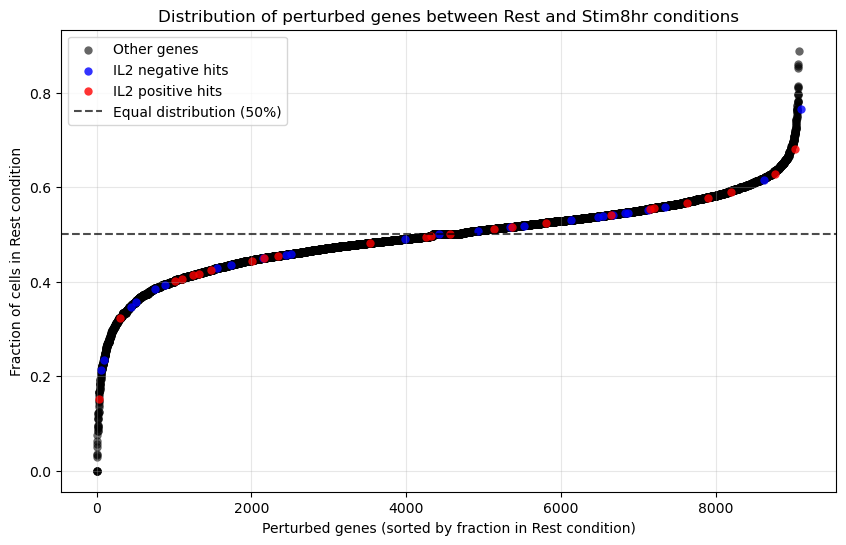

In [11]:
perturb_df = sc.get.obs_df(mdata_cVI['background'], ['louvain', 'perturbed_gene_name', 'culture_condition'])
count_cond_df = perturb_df.groupby(['perturbed_gene_name', 'culture_condition']).count().reset_index().pivot(index='perturbed_gene_name', columns='culture_condition', values='louvain')
count_cond_df['total'] = count_cond_df.Rest + count_cond_df.Stim8hr
count_cond_df['frac_Rest'] = (count_cond_df['Rest']/count_cond_df['total'])

count_cond_df['Schmidt_hits'] = np.nan
count_cond_df['Schmidt_hits'] = np.where(count_cond_df.index.isin(hit_type_dict['Positive Hit']), 'IL2_pos_hit', count_cond_df['Schmidt_hits'])
count_cond_df['Schmidt_hits'] = np.where(count_cond_df.index.isin(hit_type_dict['Negative Hit']), 'IL2_neg_hit', count_cond_df['Schmidt_hits'])

count_cond_df['essential_genes'] = np.nan
count_cond_df['essential_genes'] = np.where(count_cond_df.index.isin(core_essential), 'gold standard essential', count_cond_df['essential_genes'])
count_cond_df['essential_genes'] = np.where(count_cond_df.index.isin(core_nonessential), 'gold standard non-essential', count_cond_df['essential_genes'])


# Sort the dataframe by fraction of cells in Rest condition
sorted_df = count_cond_df.loc[high_counts].sort_values(['frac_Rest'])

# Create figure and axis
plt.figure(figsize=(10, 6))


# First plot non-hit genes (NaN values in Schmidt_hits)
non_hits = sorted_df[sorted_df['Schmidt_hits'] == 'nan']
sns.scatterplot(x=range(len(non_hits)), y=non_hits['frac_Rest'], 
                alpha=0.6, 
                color='black',
                linewidth=0,
                label='Other genes')

# Plot negative hits
neg_hits = sorted_df[sorted_df['Schmidt_hits'] == 'IL2_neg_hit']
sns.scatterplot(x=[sorted_df.index.get_loc(idx) for idx in neg_hits.index], 
                y=neg_hits['frac_Rest'],
                alpha=0.8,
                color='blue',
                linewidth=0,
                label='IL2 negative hits')

# Plot positive hits on top
pos_hits = sorted_df[sorted_df['Schmidt_hits'] == 'IL2_pos_hit']
sns.scatterplot(x=[sorted_df.index.get_loc(idx) for idx in pos_hits.index], 
                y=pos_hits['frac_Rest'],
                alpha=0.8,
                color='red',
                linewidth=0,
                label='IL2 positive hits')

# Add a horizontal dotted line at y=0.5 to indicate equal distribution
plt.axhline(y=0.5, color='black', linestyle='--', alpha=0.7, label='Equal distribution (50%)')
plt.legend()

plt.xlabel('Perturbed genes (sorted by fraction in Rest condition)')
plt.ylabel('Fraction of cells in Rest condition')
plt.title('Distribution of perturbed genes between Rest and Stim8hr conditions')
plt.grid(alpha=0.3)

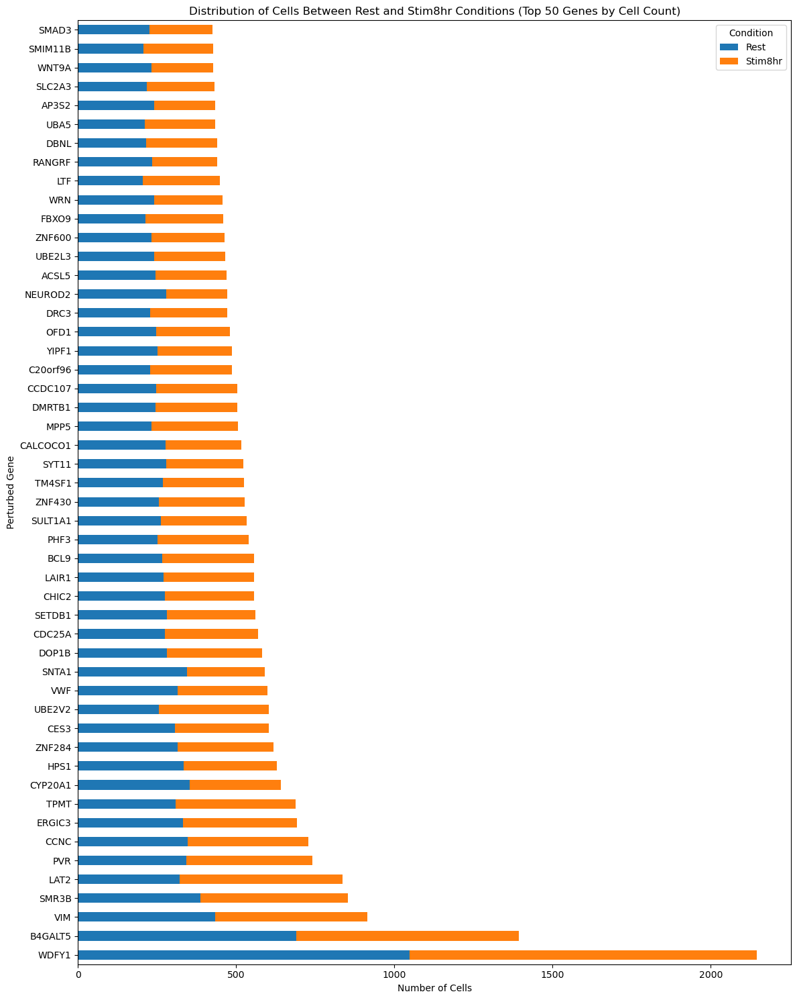

In [12]:
# Calculate total cells per perturbation
sorted_df['total'] = sorted_df['Rest'] + sorted_df['Stim8hr']

# Sort by total number of cells
total_sorted_df = sorted_df.sort_values('total', ascending=False)

# Get the top 50 rows of the sorted dataframe (most cells)
top_50 = total_sorted_df.head(50)

# Create a figure with appropriate height
plt.figure(figsize=(12, 15))

# Create a stacked bar plot
top_50[['Rest', 'Stim8hr']].plot(kind='barh', stacked=True, 
                                color=['#1f77b4', '#ff7f0e'],
                                ax=plt.gca())

# Set labels and title
plt.xlabel('Number of Cells')
plt.ylabel('Perturbed Gene')
plt.title('Distribution of Cells Between Rest and Stim8hr Conditions (Top 50 Genes by Cell Count)')

# Add a legend
plt.legend(title='Condition')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

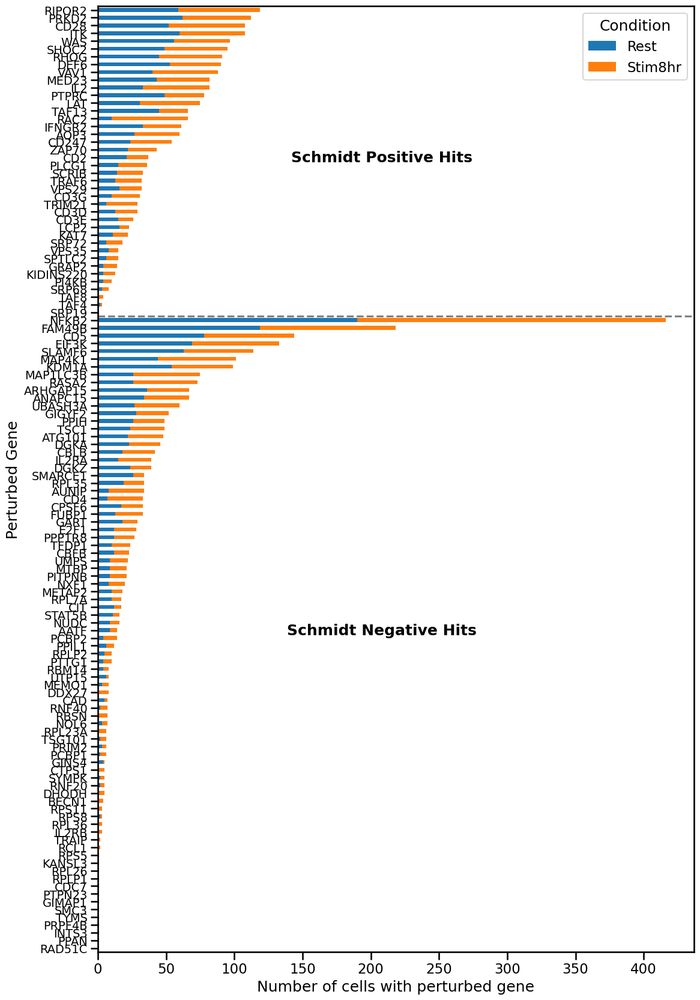

In [33]:
# Filter for Schmidt positive and negative hits
sorted_df = count_cond_df.sort_values(['total'])
pos_hits = sorted_df[sorted_df['Schmidt_hits'] == 'IL2_pos_hit']
neg_hits = sorted_df[sorted_df['Schmidt_hits'] == 'IL2_neg_hit']

# Combine them into a single dataframe
selected_genes = pd.concat([neg_hits, pos_hits])

# Create a figure with larger height to accommodate all genes
plt.figure(figsize=(12, 17))

# Create a stacked bar plot
selected_genes[['Rest', 'Stim8hr']].plot(kind='barh', stacked=True, 
                                        color=['#1f77b4', '#ff7f0e'],
                                        ax=plt.gca())

# Set labels and title
plt.xlabel('Number of cells with perturbed gene')
plt.ylabel('Perturbed Gene')
# plt.title('Distribution of Cells Between Rest and Stim8hr Conditions (Schmidt Hits)')

# Add a legend
plt.legend(title='Condition')

# Reduce the fontsize of y-axis tick labels
plt.yticks(fontsize=14)

# Add a horizontal line to separate positive and negative hits
plt.axhline(y=len(neg_hits)-0.5, color='black', linestyle='--', alpha=0.5)

# Add text labels to indicate the groups
plt.text(selected_genes[['Rest', 'Stim8hr']].sum(axis=1).max()*0.5, len(neg_hits)/2, 
         'Schmidt Negative Hits', 
         ha='center', va='center', fontweight='bold')
plt.text(selected_genes[['Rest', 'Stim8hr']].sum(axis=1).max()*0.5, len(neg_hits) + len(pos_hits)/2, 
         'Schmidt Positive Hits', 
         ha='center', va='center', fontweight='bold')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

(array([0. , 0.5, 1. , 1.5, 2. , 2.5, 3. , 3.5, 4. ]),
 [Text(0, 0.0, '0.0'),
  Text(0, 0.5, '0.5'),
  Text(0, 1.0, '1.0'),
  Text(0, 1.5, '1.5'),
  Text(0, 2.0, '2.0'),
  Text(0, 2.5, '2.5'),
  Text(0, 3.0, '3.0'),
  Text(0, 3.5, '3.5'),
  Text(0, 4.0, '4.0')])

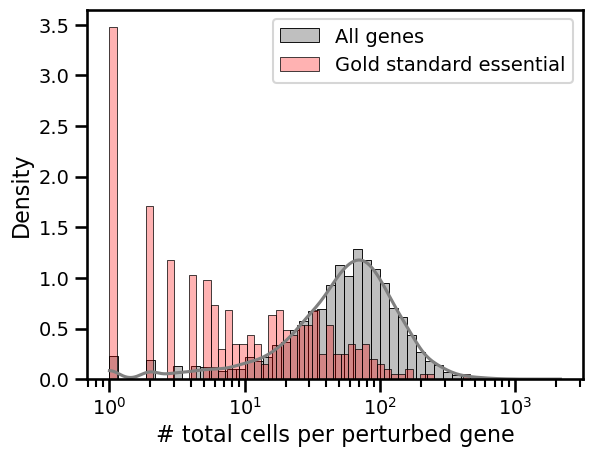

In [34]:
# Create histogram with density lines comparing IL2_neg_hit genes with all genes
neg_hits_df = count_cond_df[count_cond_df['essential_genes'] == 'gold standard essential']
pos_hits_df = count_cond_df[count_cond_df['essential_genes'] == 'gold standard non-essential']
all_genes_df = count_cond_df[count_cond_df.index != 'NTC']  # All genes except NTC

# Create the plot
ax = sns.histplot(data=all_genes_df, x='total', bins=50,
                 stat='density', common_norm=False, log_scale=True,
                 color='gray', alpha=0.5, label='All genes', kde=True)

# sns.histplot(data=pos_hits_df, x='total', bins=50,
#             stat='density', common_norm=False, log_scale=True,
#             color='blue', alpha=0.3, ax=ax, label='Gold standard non-essential')

sns.histplot(data=neg_hits_df, x='total', bins=50,
            stat='density', common_norm=False, log_scale=True,
            color='red', alpha=0.3, ax=ax, label='Gold standard essential')

# Increase font sizes
plt.legend(fontsize=14)
plt.xlabel('# total cells per perturbed gene', fontsize=16)
plt.ylabel('Density', fontsize=16)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)


In [125]:
neg_hits_df.sort_values('total', ascending=False)[0:10].index.tolist()

['UBE2L3',
 'TAF1B',
 'YARS2',
 'TWNK',
 'GTF2H2C',
 'NUDT4',
 'MEPCE',
 'TOP2A',
 'CCNA2',
 'TFAM']

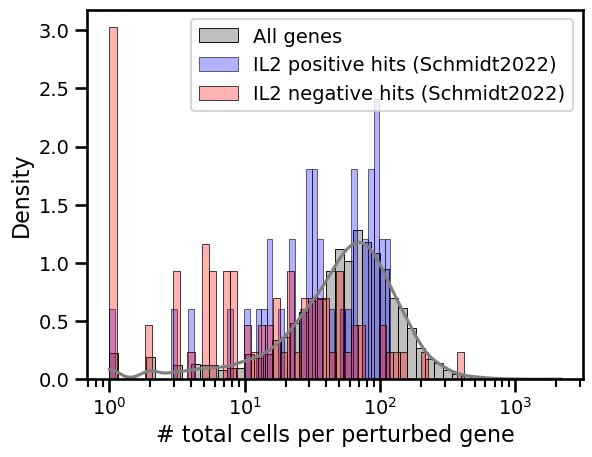

In [35]:
# Create histogram with density lines comparing IL2_neg_hit genes with all genes
neg_hits_df = count_cond_df[count_cond_df['Schmidt_hits'] == 'IL2_neg_hit']
pos_hits_df = count_cond_df[count_cond_df['Schmidt_hits'] == 'IL2_pos_hit']
all_genes_df = count_cond_df[count_cond_df.index != 'NTC']  # All genes except NTC

# Create the plot
ax = sns.histplot(data=all_genes_df, x='total', bins=50,
                 stat='density', common_norm=False, log_scale=True,
                 color='gray', alpha=0.5, label='All genes', kde=True)

# Add IL2_neg_hit genes on top
sns.histplot(data=pos_hits_df, x='total', bins=50,
            stat='density', common_norm=False, log_scale=True,
            color='blue', alpha=0.3, ax=ax, label='IL2 positive hits (Schmidt2022)')

sns.histplot(data=neg_hits_df, x='total', bins=50,
            stat='density', common_norm=False, log_scale=True,
            color='red', alpha=0.3, ax=ax, label='IL2 negative hits (Schmidt2022)')

# Increase font sizes
plt.legend(fontsize=14);
plt.xlabel('# total cells per perturbed gene', fontsize=16);
plt.ylabel('Density', fontsize=16);
plt.xticks(fontsize=14);
plt.yticks(fontsize=14);


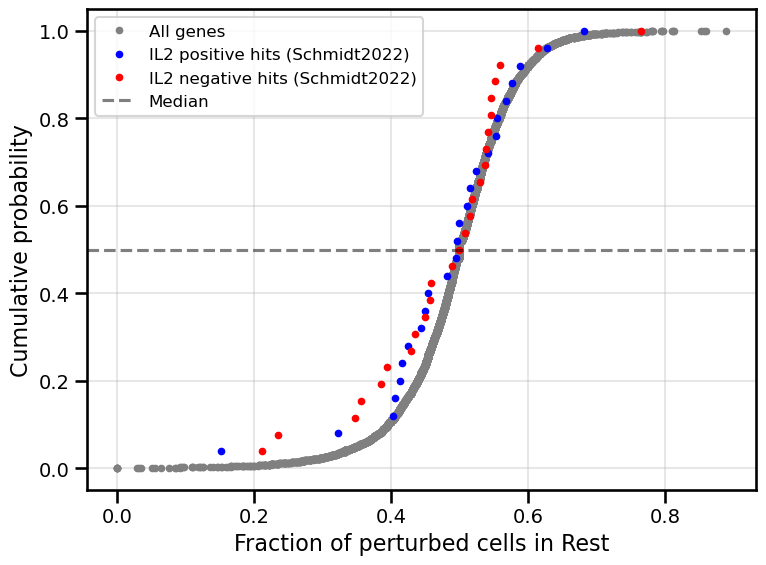

In [49]:
high_counts = mdata_cVI['salient'].obs['perturbed_gene_name'].value_counts()
high_counts = high_counts[high_counts > 30].index.tolist()

# Create histogram with density lines comparing IL2_neg_hit genes with all genes
neg_hits_df = count_cond_df[count_cond_df.index.isin(high_counts) & (count_cond_df['Schmidt_hits'] == 'IL2_neg_hit')]
pos_hits_df = count_cond_df[count_cond_df.index.isin(high_counts) & (count_cond_df['Schmidt_hits'] == 'IL2_pos_hit')]
all_genes_df = count_cond_df[(count_cond_df.index.isin(high_counts)) &(count_cond_df.index != 'NTC')]  # All genes except NTC

# Create a new dataframe for boxplot
boxplot_data = pd.DataFrame({
    'Fraction in Rest': all_genes_df['frac_Rest'],
    'Group': 'All genes'
})

# Add IL2 positive and negative hits
boxplot_data = pd.concat([
    boxplot_data,
    pd.DataFrame({
        'Fraction in Rest': pos_hits_df['frac_Rest'],
        'Group': 'IL2 positive hits (Schmidt2022)'
    }),
    pd.DataFrame({
        'Fraction in Rest': neg_hits_df['frac_Rest'],
        'Group': 'IL2 negative hits (Schmidt2022)'
    })
])

# Create cumulative distribution plot instead of boxplot
plt.figure(figsize=(8, 6))

# Plot cumulative distributions for each group
for group, color in zip(['All genes', 'IL2 positive hits (Schmidt2022)', 'IL2 negative hits (Schmidt2022)'], 
                        ['gray', 'blue', 'red']):
    group_data = boxplot_data[boxplot_data['Group'] == group]['Fraction in Rest']
    # Sort the data and calculate cumulative distribution
    sorted_data = np.sort(group_data)
    cumulative = np.arange(1, len(sorted_data) + 1) / len(sorted_data)
    plt.plot(sorted_data, cumulative, '.', color=color, linewidth=2, label=group)

# Add reference line
plt.axhline(y=0.5, color='black', linestyle='--', alpha=0.5, label='Median')

# Increase font sizes
plt.xlabel('Fraction of perturbed cells in Rest', fontsize=16)
plt.ylabel('Cumulative probability', fontsize=16)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.legend(fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()


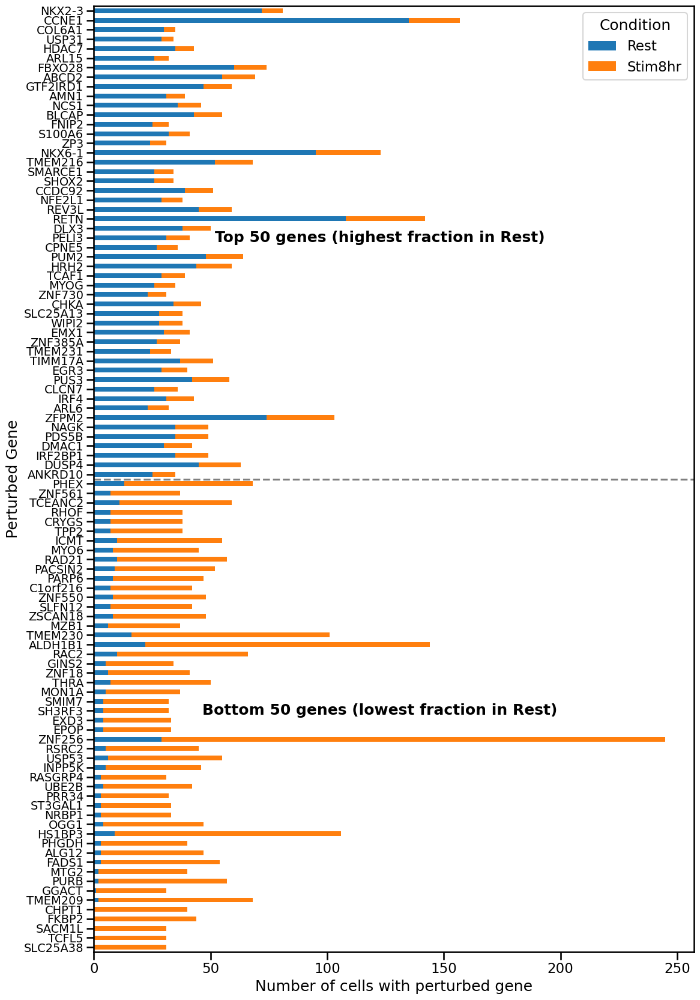

In [ ]:
# Get the top 50 and bottom 50 rows of the sorted dataframe
bottom_50 = sorted_df.head(50)
top_50 = sorted_df.tail(50)

# Combine them into a single dataframe
selected_genes = pd.concat([bottom_50, top_50])

# Create a figure with larger height to accommodate more genes
plt.figure(figsize=(12, 17))

# Create a stacked bar plot
selected_genes[['Rest', 'Stim8hr']].plot(kind='barh', stacked=True, 
                                        color=['#1f77b4', '#ff7f0e'],
                                        ax=plt.gca())

# Set labels and title
plt.xlabel('Number of cells with perturbed gene')
plt.ylabel('Perturbed Gene')
# plt.title('Distribution of Cells Between Rest and Stim8hr Conditions (Top and Bottom 50 Genes)')

# Add a legend
plt.legend(title='Condition')

# Reduce the fontsize of y-axis tick labels
plt.yticks(fontsize=14)

# Add a horizontal line to separate top and bottom genes
plt.axhline(y=49.5, color='black', linestyle='--', alpha=0.5)

# Add text labels to indicate the groups
plt.text(selected_genes[['Rest', 'Stim8hr']].sum(axis=1).max()*0.5, 25, 
         'Bottom 50 genes (lowest fraction in Rest)', 
         ha='center', va='center', fontweight='bold')
plt.text(selected_genes[['Rest', 'Stim8hr']].sum(axis=1).max()*0.5, 75, 
         'Top 50 genes (highest fraction in Rest)', 
         ha='center', va='center', fontweight='bold')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

## Examine contrastiveVI latents

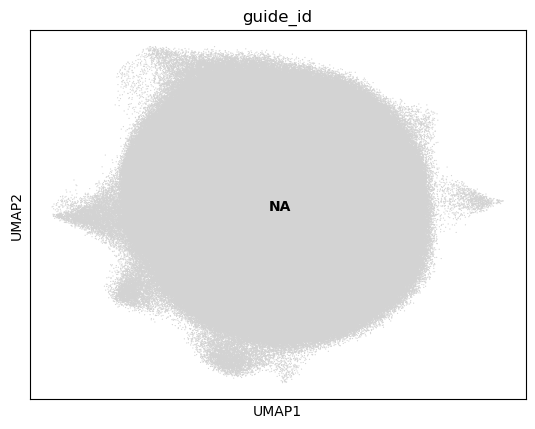

In [13]:
sc.pl.umap(mdata_cVI['salient'], color='guide_id', size=3, legend_loc='on data', groups=['multi_sgRNA'])

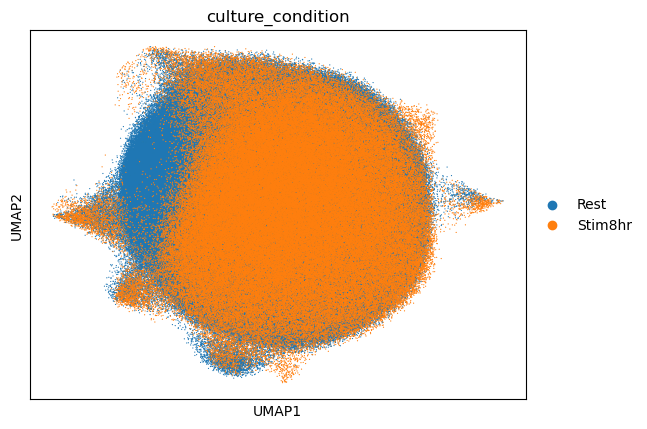

In [8]:
sc.pl.umap(mdata_cVI['salient'], color='culture_condition',size=3)

In [14]:
high_counts = mdata_cVI['salient'].obs['perturbed_gene_name'].value_counts()
high_counts = high_counts[high_counts > 30].index.tolist()

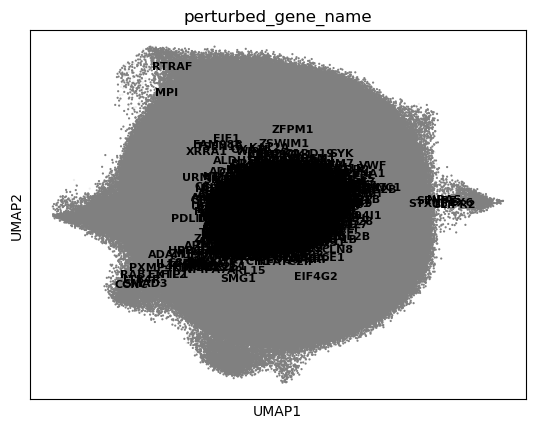

In [10]:
sc.pl.umap(mdata_cVI['salient'], color='perturbed_gene_name', legend_loc='on data', size=10, legend_fontsize=8, groups=high_counts, na_color='#eeeeee')

In [9]:
mdata_cVI['background'].obs['no_guide'] = mdata_cVI['background'].obs['guide_id'].isna()

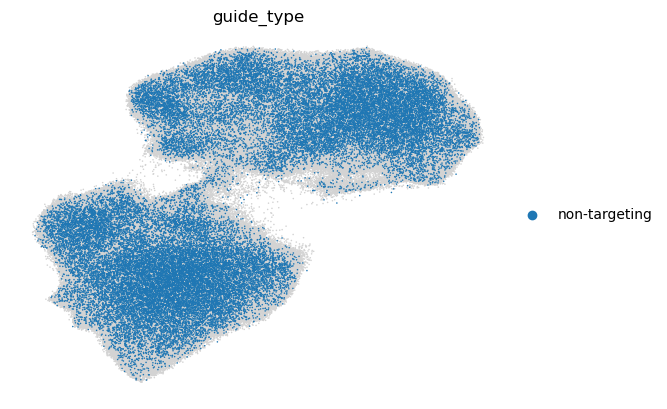

/home/emmadann/miniforge3/envs/rapids_singlecell/lib/python3.11/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


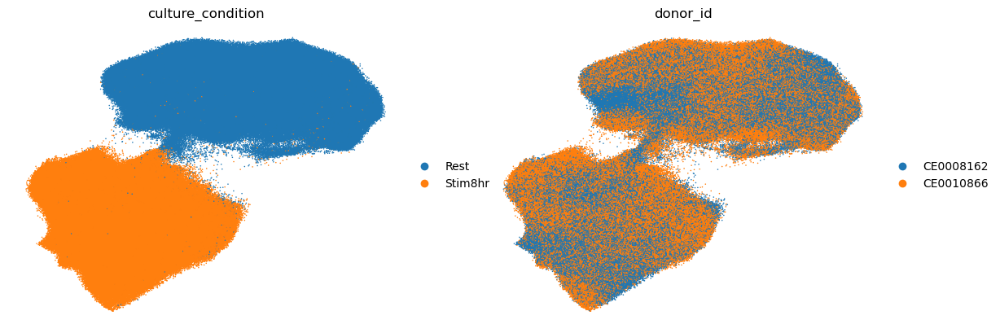

In [10]:
sc.pl.umap(mdata_cVI['background'], color='guide_type', size=5, groups='non-targeting', frameon=False, na_in_legend=False)
np.random.seed(0)
random_indices = np.random.permutation(list(range(mdata_cVI['background'].shape[0])))
sc.pl.umap(mdata_cVI['background'][random_indices,:], color=['culture_condition', 'donor_id'], size=5, frameon=False, wspace=0.1)
# sc.pl.umap(mdata_cVI['background'][mdata_cVI['background'].obs['culture_condition'] == 'Stim8hr'], color=['MKI67', 'GZMB','IL2RA'], size=3)

/home/emmadann/miniforge3/envs/rapids_singlecell/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1152: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(


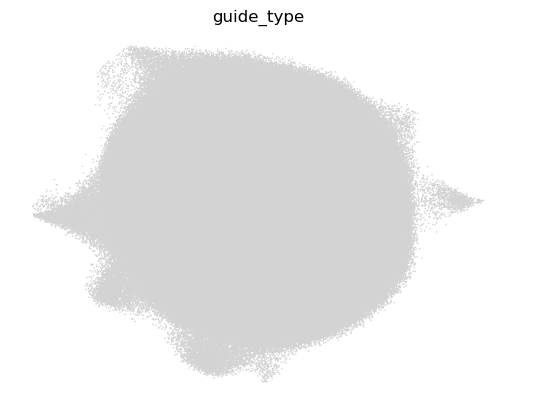

/home/emmadann/miniforge3/envs/rapids_singlecell/lib/python3.11/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


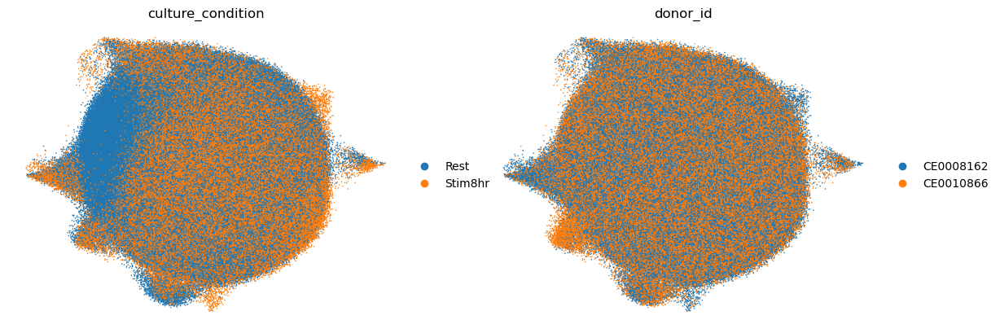

In [11]:
sc.pl.umap(mdata_cVI['salient'], color='guide_type', size=5, groups='non-targeting', frameon=False, na_in_legend=False)
np.random.seed(0)
random_indices = np.random.permutation(list(range(mdata_cVI['salient'].shape[0])))
sc.pl.umap(mdata_cVI['salient'][random_indices,:], color=['culture_condition', 'donor_id'], size=5, frameon=False, wspace=0.1)
# sc.pl.umap(mdata_cVI['background'][mdata_cVI['background'].obs['culture_condition'] == 'Stim8hr'], color=['MKI67', 'GZMB','IL2RA'], size=3)

In [16]:
mdata_cVI['background'].var_names = mdata_cVI['background'].var['gene_name'].values

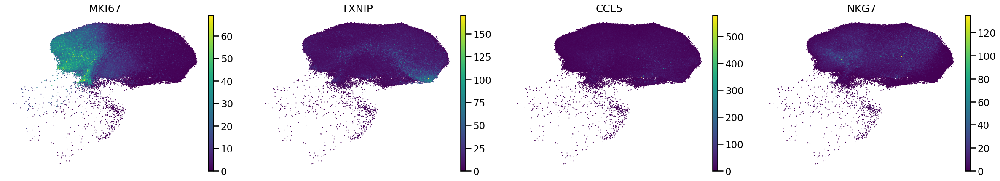

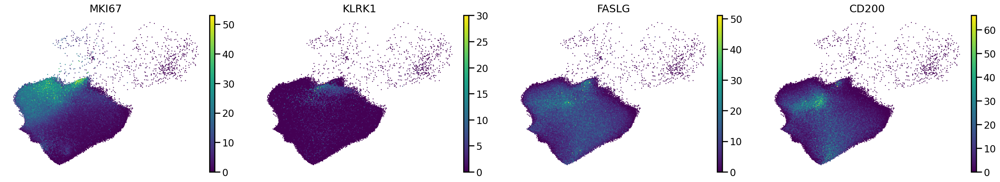

In [17]:
specific_genes = ['KLRK1', "TXNIP", 'TC2N', 'FASLG', 'CD200', 'CCL5', 'NKG7', 'GZMB']
sns.set_context('talk')
sc.pl.umap(mdata_cVI['background'][mdata_cVI['background'].obs['culture_condition'] == 'Rest'],  
           color=['MKI67', "TXNIP", 'CCL5', 'NKG7'], 
           ncols=5,  
           size=10, 
           frameon=False,
           legend_fontsize=12)
sc.pl.umap(mdata_cVI['background'][mdata_cVI['background'].obs['culture_condition'] == 'Stim8hr'],  
           color=['MKI67', 'KLRK1', 'FASLG', 'CD200'], 
           ncols=5, 
           size=10, 
           frameon=False,
           groups='non-targeting', 
           legend_fontsize=12)

In [163]:
rsc.tl.louvain(mdata_cVI['background'], resolution=0.8)

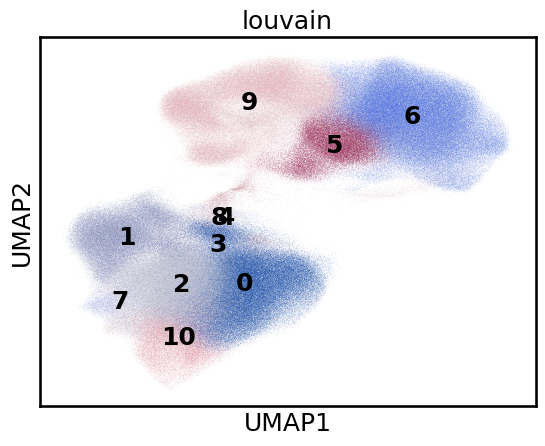

In [164]:
sns.set_context('talk')
sc.pl.umap(mdata_cVI['background'], color='louvain', legend_loc='on data')

In [165]:
mdata_cVI['background'].obs['louvain'].value_counts()

louvain
6     230132
0     163243
9     156249
2     129446
1      97207
5      59872
10     38243
3      26724
7      11464
4      11365
8       5145
Name: count, dtype: int64

In [16]:
import scipy.sparse as sp
X_norm = (mdata_cVI['background'].X.T / mdata_cVI['background'].obs['total_counts'].values).T
X_norm = sp.csr_matrix(X_norm)
mdata_cVI['background'].X = X_norm * 10000
sc.pp.log1p(mdata_cVI['background'])

In [17]:
ad_stim = mdata_cVI['background'][mdata_cVI['background'].obs['culture_condition'] == 'Stim8hr'].copy()
rsc.pp.neighbors(ad_stim, use_rep='contrastiveVI_background', n_neighbors=50)
rsc.tl.umap(ad_stim)

ad_rest = mdata_cVI['background'][mdata_cVI['background'].obs['culture_condition'] == 'Rest'].copy()
rsc.pp.neighbors(ad_rest, use_rep='contrastiveVI_background', n_neighbors=50)
rsc.tl.umap(ad_rest)

In [34]:
rsc.tl.louvain(ad_stim, resolution=0.3)
rsc.tl.louvain(ad_rest, resolution=0.3)

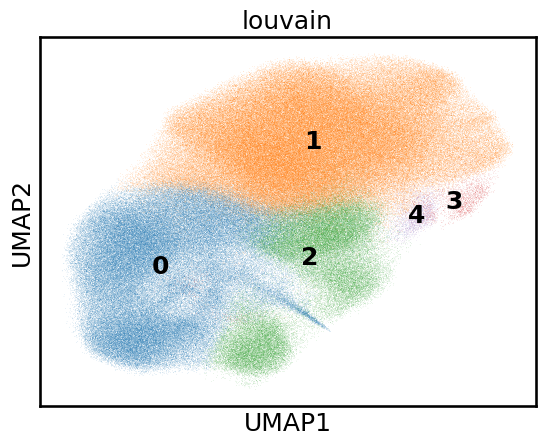

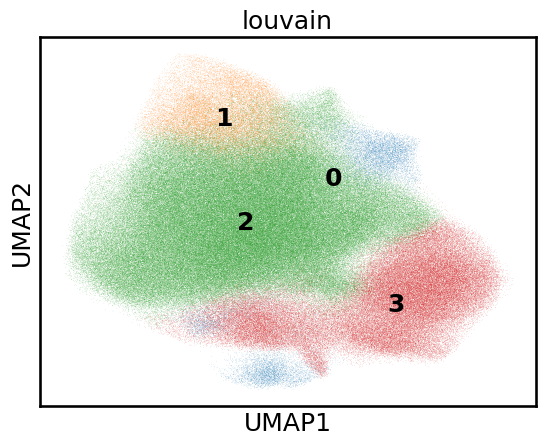

In [35]:
sc.pl.umap(ad_rest, color='louvain', legend_loc='on data')
sc.pl.umap(ad_stim, color='louvain', legend_loc='on data')

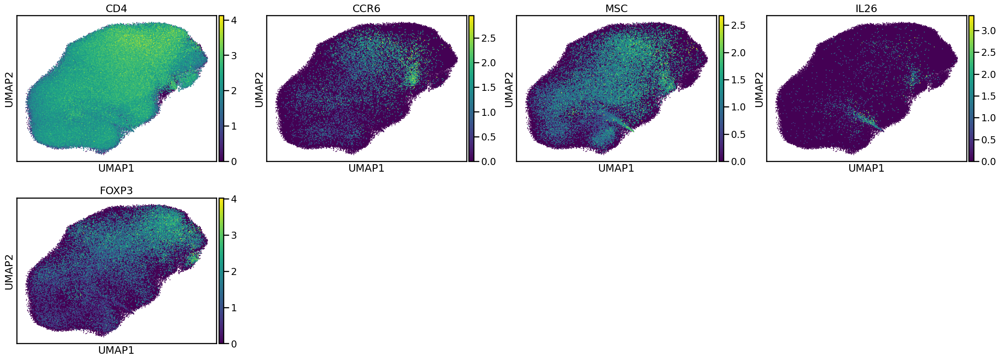

In [45]:
sc.pl.umap(
    ad_rest, 
    color=['CD4', 'CCR6', 'MSC', 'IL26', 'FOXP3'], 
    size=10)

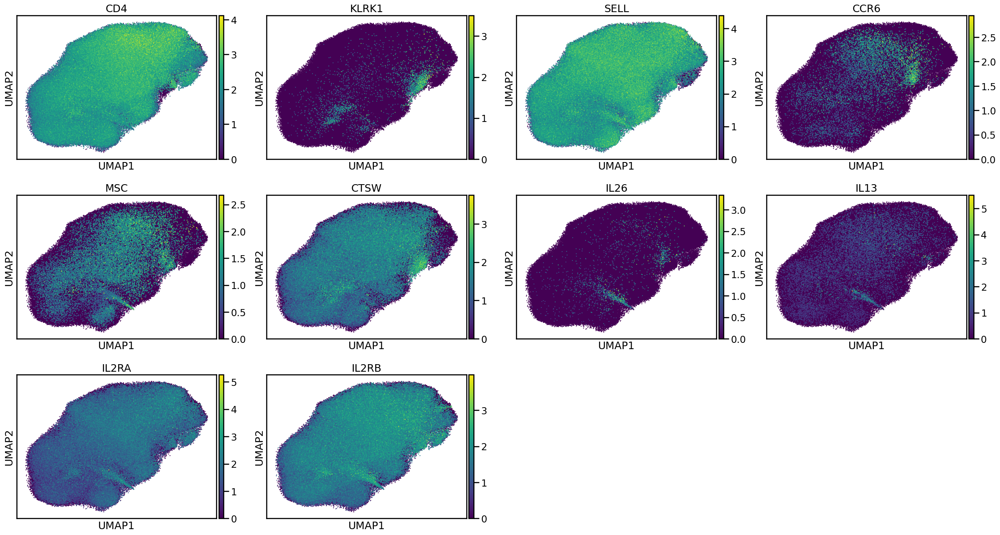

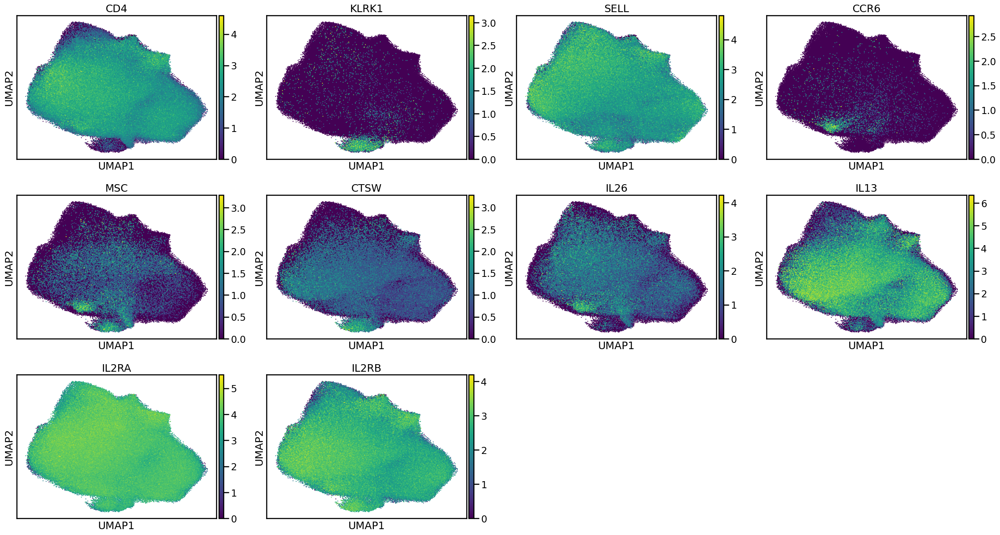

In [44]:
# sc.pl.umap(ad_stim, color='louvain', legend_loc='on data', groups=['0'], size=20)
sc.pl.umap(
    ad_rest, 
    color=['CD4','KLRK1', 'SELL', 'CCR6', 'MSC', 'CTSW','IL26', 'IL13', 'IL2RA', 'IL2RB'], 
    size=10)
sc.pl.umap(
    ad_stim, 
    color=['CD4','KLRK1', 'SELL', 'CCR6', 'MSC', 'CTSW','IL26', 'IL13', 'IL2RA', 'IL2RB'], 
    size=10)
# sc.pl.umap(ad_stim, color=['KLRK1', 'CCR6', 'IL26', 'IL13', 'IL2RA', 'IL2RB'], size=10)

In [24]:
TCELL_MARKERS_URL = 'https://docs.google.com/spreadsheets/d/1NSjrMofwd7etOJVvqHXFMNV0--gjzg8BzHMWGxK7SUI'

def load_Tcell_markers(adata: anndata.AnnData):
    Tcell_markers = pd.read_csv(f'{TCELL_MARKERS_URL}/export?format=csv')
    Tcell_markers = Tcell_markers[Tcell_markers['gene_name'].isin(adata.var['gene_name'])]
    Tcell_markers['state_program_name'] = Tcell_markers['state_program_name'].astype('category').cat.reorder_categories(Tcell_markers.state_program_name.unique())
    markers_dict = Tcell_markers.groupby('state_program_name')['gene_name'].apply(list).to_dict()
    return markers_dict

group_by = 'culture_condition'
markers_dict = load_Tcell_markers(mdata_cVI['background'])
# markers_dict['specific_genes'] = specific_genes
order_samples = mdata_cVI['background'].obs.sort_values([group_by])['louvain'].astype(str).unique()
# mdata_cVI['background'].obs['louvain'] = mdata_cVI['background'].obs['louvain'].cat.reorder_categories(order_samples)
# sc.pl.dotplot(mdata_cVI['background'], markers_dict, groupby='louvain')

/tmp/ipykernel_2546240/2426727149.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  markers_dict = Tcell_markers.groupby('state_program_name')['gene_name'].apply(list).to_dict()


In [26]:
markers_dict = {
    'general': ['CD4'],
 'Naive': ['SELL', 'LEF1', 'TCF7'],
 'Cytotoxic': ['NKG7', 'PRF1', 'GZMB', 'KLRK1'],
 'Treg': ['IL2RA', 'CTLA4', 'TNFRSF18', 'IL10'],
 'Innate like': ['ZBTB16'],
 'Th1': ['TBX21', 'IFNG', 'IL2RB', 'TNF'],
 'Th2': ['GATA3', 'CCR4', 'IL4', 'IL5', 'IL13'],
 'Th17': ['CCR6', 'IL26', 'CTSW', 'MSC', 'CD9'],
 'Cycling': ['MKI67', 'PCNA', 'MCM7', 'AURKA'],
 'gdT': ['TRDC', 'TRGC1', 'TRGC2'],
 'other':['TXNIP', 'TIGIT', 'FASLG', 'CCL5', 'MYB']
 }

In [29]:
ad_stim.var_names = ad_stim.var['gene_name'].values
ad_rest.var_names = ad_rest.var['gene_name'].values

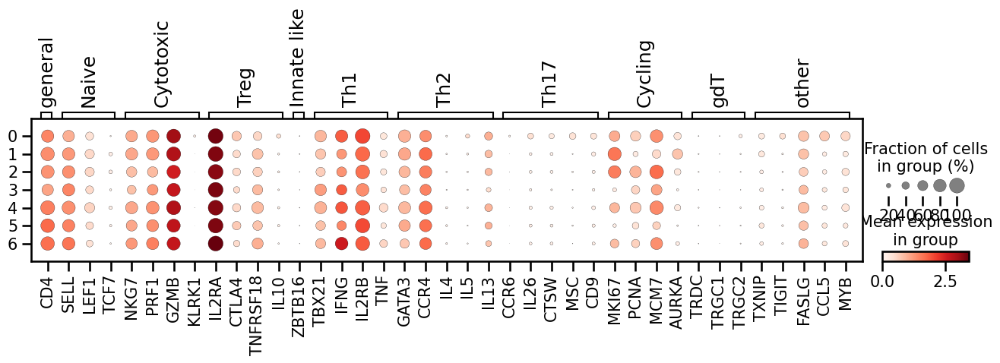

In [32]:
# sc.tl.dendrogram(ad_stim[ad_stim.obs['perturbed_gene_name'] == 'NTC'], groupby='louvain', use_rep='contrastiveVI_background')
sns.set_context('talk')
sc.pl.dotplot(ad_stim[ad_stim.obs['perturbed_gene_name'] == 'NTC'], markers_dict, groupby='louvain')

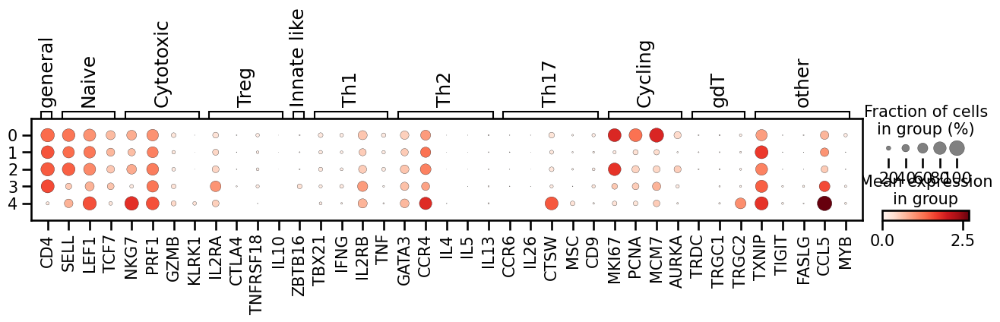

In [33]:
sc.pl.dotplot(ad_rest[ad_rest.obs['perturbed_gene_name'] == 'NTC'], markers_dict, groupby='louvain')


In [ ]:
# Calculate the count of cells by louvain cluster and culture_condition
condition_counts = mdata_cVI['background'].obs[['louvain', 'culture_condition']].groupby(['louvain', 'culture_condition']).size().unstack(fill_value=0)

# Calculate the fraction of each culture_condition within each louvain cluster
condition_fractions = condition_counts.div(condition_counts.sum(axis=1), axis=0)

# Extract the 'Rest' and 'Stim8hr' culture condition fractions
rest_fraction = condition_fractions['Rest']
stim8hr_fraction = condition_fractions['Stim8hr']

# Create a figure and axis
fig, ax = plt.subplots(figsize=(12, 6))

# Plot stacked bar chart
width = 0.8
bottom_values = np.zeros(len(rest_fraction))

# Plot Rest bars at the bottom
rest_bars = ax.bar(rest_fraction.index, rest_fraction.values, width, label='Rest')

# Plot Stim8hr bars stacked on top of Rest bars
stim8hr_bars = ax.bar(stim8hr_fraction.index, stim8hr_fraction.values, width, 
                      bottom=rest_fraction.values, color='orange', label='Stim8hr')

ax.set_xlabel('Louvain Cluster')
ax.set_ylabel('Fraction of Cells')
ax.set_title('Fraction of Rest and Stim8hr Condition Cells in Each Louvain Cluster')
ax.legend()
plt.tight_layout()
plt.show()

/tmp/ipykernel_2044301/3266201327.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  condition_counts = ad_stim.obs[['louvain', 'culture_condition']].groupby(['louvain', 'culture_condition']).size().unstack(fill_value=0)


KeyError: 'Rest'

In [155]:
condition_counts

culture_condition,Rest,Stim8hr
louvain,,
1,74743,55
10,64711,96
3,127948,397
4,81725,158
7,30770,126
8,69733,103
9,6255,14408
11,3401,13835
14,900,5192


In [159]:
mdata_cVI['background'].obs[(mdata_cVI['background'].obs['louvain'] == '1') & (mdata_cVI['background'].obs['culture_condition'] == 'Stim8hr')].value_counts('perturbed_gene_name')

perturbed_gene_name
NTC        3
NAGA       1
PCCA       1
APOL3      1
BLOC1S6    1
          ..
GPR135     0
GPR137     0
GPR137B    0
GPR146     0
ZZEF1      0
Name: count, Length: 12107, dtype: int64

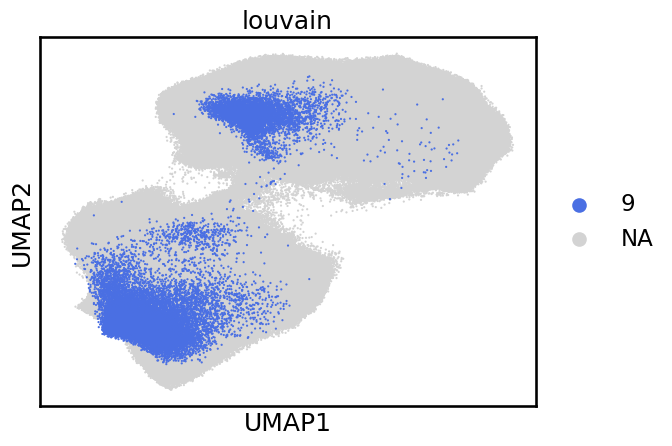

In [34]:
sc.pl.umap(mdata_cVI['background'], color='louvain', groups=['9'], size=10)

Text(0.5, 1.02, 'Distribution of gene perturbations across Louvain clusters')

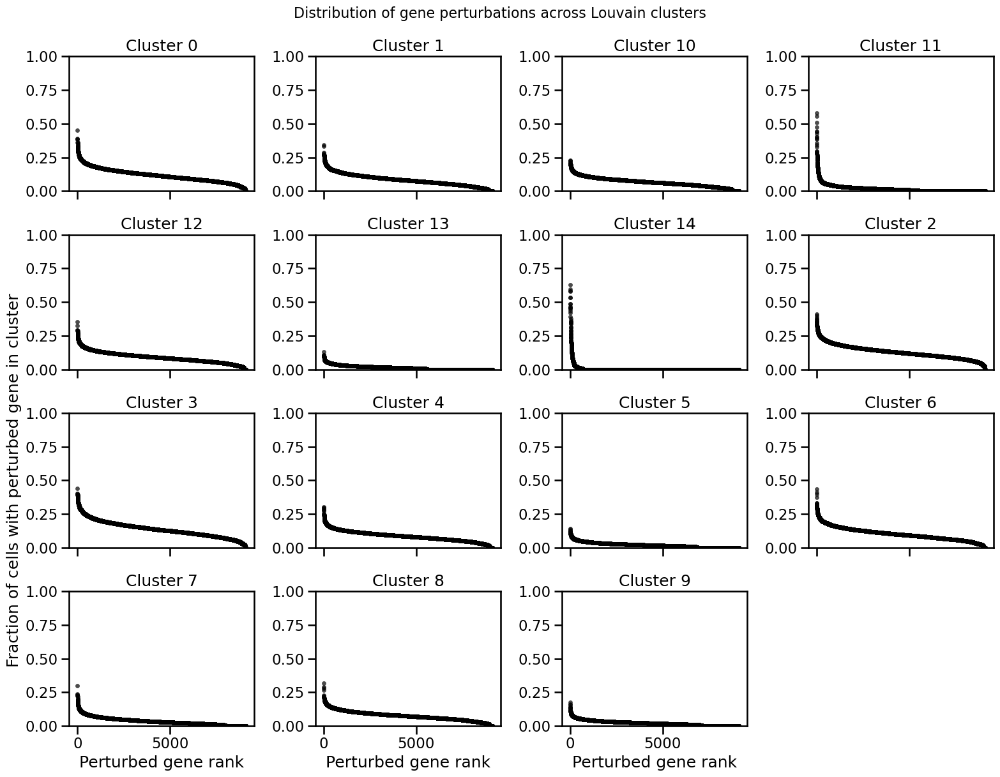

In [60]:
perturb_df = sc.get.obs_df(mdata_cVI['background'], ['louvain', 'perturbed_gene_name', 'culture_condition'])
perturb_df = perturb_df[perturb_df.perturbed_gene_name.isin(high_counts)]

# Create a dataframe to store fractions for all louvain clusters
louvain_clusters = perturb_df['louvain'].unique()
fraction_df = pd.DataFrame()

# Calculate fractions for each louvain cluster
for cluster in louvain_clusters:
    n_cluster = perturb_df[perturb_df.louvain == cluster].value_counts('perturbed_gene_name')
    n_other = perturb_df[perturb_df.louvain != cluster].value_counts('perturbed_gene_name')
    
    temp_df = pd.concat([n_cluster, n_other], axis=1)
    temp_df.columns = [f'n_{cluster}', 'n_other']
    temp_df[f'frac_{cluster}'] = temp_df[f'n_{cluster}'] / (temp_df[f'n_{cluster}'] + temp_df['n_other'])
    
    # Filter for high counts and sort by fraction
    temp_df = temp_df[temp_df.index.isin(high_counts)].copy()
    temp_df = temp_df.sort_values(f'frac_{cluster}', ascending=False).reset_index()
    temp_df['rank'] = range(len(temp_df))
    temp_df['cluster'] = cluster
    temp_df['fraction'] = temp_df[f'frac_{cluster}']
    
    # Add to main dataframe
    fraction_df = pd.concat([fraction_df, temp_df[['perturbed_gene_name', 'cluster', 'fraction', 'rank']]])

# Convert perturbed_gene_name to string
fraction_df['perturbed_gene_name'] = fraction_df['perturbed_gene_name'].astype(str)

# Define a distinct color palette with high contrast between colors
distinct_colors = ['#e6194B', '#3cb44b', '#ffe119', '#4363d8', '#f58231', 
                   '#911eb4', '#42d4f4', '#f032e6', '#bfef45', '#fabed4', 
                   '#469990', '#dcbeff', '#9A6324', '#800000']

# Get unique clusters and determine subplot grid dimensions
unique_clusters = sorted(fraction_df['cluster'].unique())
n_clusters = len(unique_clusters)
n_cols = 4  # Number of columns in the subplot grid
n_rows = (n_clusters + n_cols - 1) // n_cols  # Calculate number of rows needed

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 3*n_rows), sharex=True)
axes = axes.flatten()

# Plot each cluster in a separate subplot
for i, cluster in enumerate(unique_clusters):
    cluster_data = fraction_df[fraction_df['cluster'] == cluster]
    
    # Plot data
    sns.scatterplot(
        data=cluster_data, 
        x='rank', 
        y='fraction',
        color='black',
        s=20, 
        alpha=0.7,
        ax=axes[i],
        edgecolor=None
    )
    # Set subplot title and labels
    axes[i].set_title(f'Cluster {cluster}')
    # Only add x-axis label to bottom row
    if i >= len(unique_clusters) - n_cols:
        axes[i].set_xlabel('Perturbed gene rank')
    else:
        axes[i].set_xlabel('')
    
    # Only add y-axis label to leftmost column and central row
    if i % n_cols == 0 and i // n_cols == n_rows // 2:
        axes[i].set_ylabel('Fraction of cells with perturbed gene in cluster')
    else:
        axes[i].set_ylabel('')
    # Set y-axis limits to be the same for all subplots
    axes[i].set_ylim(0, 1)

# Hide any unused subplots
for j in range(i+1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.suptitle('Distribution of gene perturbations across Louvain clusters', y=1.02, fontsize=16)

In [78]:
group_oi = fraction_df[fraction_df['cluster'] == '11'][0:30]['perturbed_gene_name'].tolist()
# fraction_df[fraction_df['cluster'] == '11'][0:30]

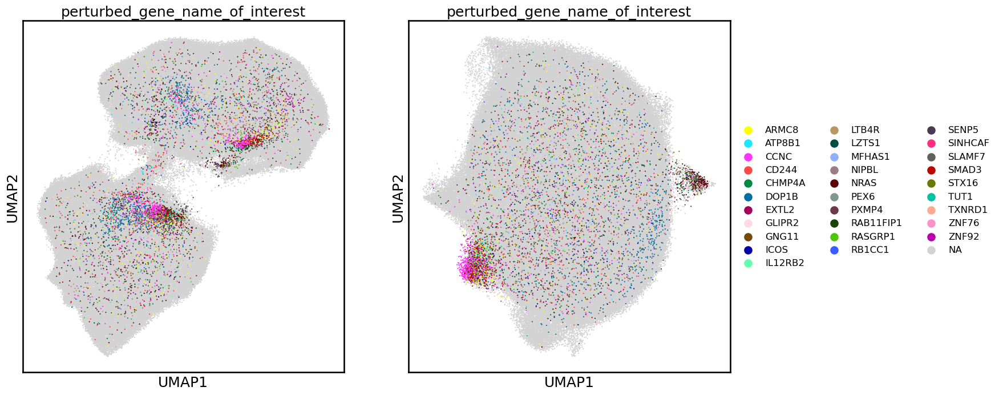

In [79]:
# group_oi = count_rest.loc[genes_over_x_percent.index].sort_values('10', ascending=False).iloc[0:5].index
mdata_cVI['background'].obs['perturbed_gene_name_of_interest'] = np.where(mdata_cVI['background'].obs['perturbed_gene_name'].isin(group_oi), mdata_cVI['background'].obs['perturbed_gene_name'], np.nan)
# del mdata_cVI['background'].uns['perturbed_gene_name_of_interest_colors']
mdata_cVI['salient'].obs['perturbed_gene_name_of_interest'] = np.where(mdata_cVI['salient'].obs['perturbed_gene_name'].isin(group_oi), mdata_cVI['salient'].obs['perturbed_gene_name'], np.nan)
# del mdata_cVI['salient'].uns['perturbed_gene_name_of_interest_colors']

fig = plt.figure(figsize=(16,8))
ax = fig.add_subplot(1, 2, 1)
sc.pl.umap(mdata_cVI['background'], color='perturbed_gene_name_of_interest', legend_loc=None, size=10, show=False, ax=ax)
ax = fig.add_subplot(1, 2, 2)
sc.pl.umap(mdata_cVI['salient'], color='perturbed_gene_name_of_interest', legend_fontsize=12, size=10, show=False, ax=ax)
plt.show()

/tmp/ipykernel_2044301/2391626069.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts = mdata_cVI['background'].obs[['louvain', 'guide_id']].groupby(['louvain', 'guide_id']).size().unstack(fill_value=0)


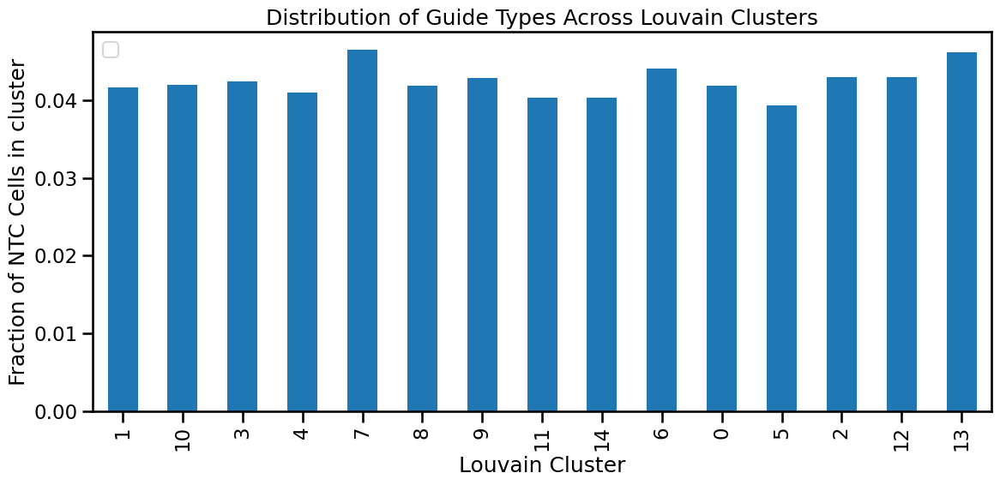

In [63]:
# Calculate the count of cells by louvain cluster and guide_id
counts = mdata_cVI['background'].obs[['louvain', 'guide_id']].groupby(['louvain', 'guide_id']).size().unstack(fill_value=0)

# Create a new DataFrame to store categorized counts
guide_categories = pd.DataFrame(index=counts.index)

# Categorize guide_ids into groups
guide_categories['no sgRNA'] = counts.loc[:, counts.columns.isna()].sum(axis=1)
guide_categories['NTC single sgRNA'] = counts.loc[:, counts.columns.str.startswith('NTC', na=False)].sum(axis=1)
guide_categories['targeting single sgRNA'] = counts.loc[:, (~counts.columns.isna() & 
                                                         ~counts.columns.str.startswith('NTC', na=False) & 
                                                         (counts.columns != 'multi_sgRNA'))].sum(axis=1)
guide_categories['multi sgRNA'] = counts.loc[:, counts.columns == 'multi_sgRNA'].sum(axis=1)

# Calculate the fraction of each guide category within each louvain cluster
fractions = guide_categories.div(guide_categories.sum(axis=1), axis=0)
fractions = fractions[['NTC single sgRNA']]
# Create a stacked bar plot
ax = fractions.plot(kind='bar', stacked=True, figsize=(12, 6), 
                   color=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728'])

ax.set_xlabel('Louvain Cluster')
ax.set_ylabel('Fraction of NTC Cells in cluster')
ax.set_title('Distribution of Guide Types Across Louvain Clusters')
ax.legend([])
plt.tight_layout()
plt.show()

In [87]:
ad_stim = mdata_cVI['background'][mdata_cVI['background'].obs['louvain'].isin(['11', '14', '0', '6', '5','2', '13'])].copy()
sc.tl.rank_genes_groups(ad_stim, groupby='louvain')

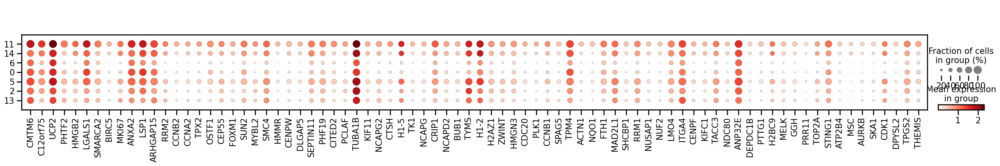

In [89]:
sc.pl.dotplot(
    ad_stim,
    sc.get.rank_genes_groups_df(ad_stim, group='11', log2fc_min=0)[0:80]['names'].tolist(),
    # sc.get.rank_genes_groups_df(mdata_cVI['background'], group='9', log2fc_min=1)[-50:]['names'].tolist(),
    groupby='louvain'
    )

In [111]:
import starcat
tcat = starcat.starCAT(reference='TCAT.V1')
tcat.ref.index

Using reference from starCAT database
Loading reference from existing cache file for reference TCAT.V1


Index(['CellCycle-G2M', 'Translation', 'HLA', 'ISG', 'Mito', 'Doublet-RBC',
       'gdT', 'CellCycle-S', 'Cytotoxic', 'Doublet-Platelet', 'NME1/FABP5',
       'Th22', 'MAIT', 'CellCycle-Late-S', 'Cytoskeleton', 'Heatshock',
       'Multi-Cytokine', 'TEMRA', 'Doublet-Myeloid', 'Metallothionein',
       'CD4-CM', 'IEG', 'CD8-EM', 'IEG2', 'CD4-Naive', 'Treg', 'Th17-Resting',
       'Poor-Quality', 'CD8-Naive', 'RGCC/MYADM', 'TIMD4/TIM3',
       'Doublet-Plasmablast', 'BCL2/FAM13A', 'IL10/IL19', 'Th2-Activated',
       'Th2-Resting', 'ICOS/CD38', 'Doublet-Bcell', 'Th1-Like', 'CTLA4/CD38',
       'CD8-Trm', 'Th17-Activated', 'Tfh-2', 'OX40/EBI3', 'CD172a/MERTK',
       'IEG3', 'Doublet-Fibroblast', 'SOX4/TOX2', 'CD40LG/TXNIP', 'Tph',
       'Exhaustion', 'Tfh-1'],
      dtype='object')

In [182]:
# Create a dictionary with top 10 genes for each program
program_top_genes = {}
for program in tcat.ref.index:
    if not program.startswith('Doublet'):
        gs = tcat.ref.loc[program].sort_values(ascending=False)[0:50].index.tolist()
        gs = np.intersect1d(gs, mdata_cVI['background'].var_names)
        if len(gs) > 0:
            program_top_genes[program] = gs

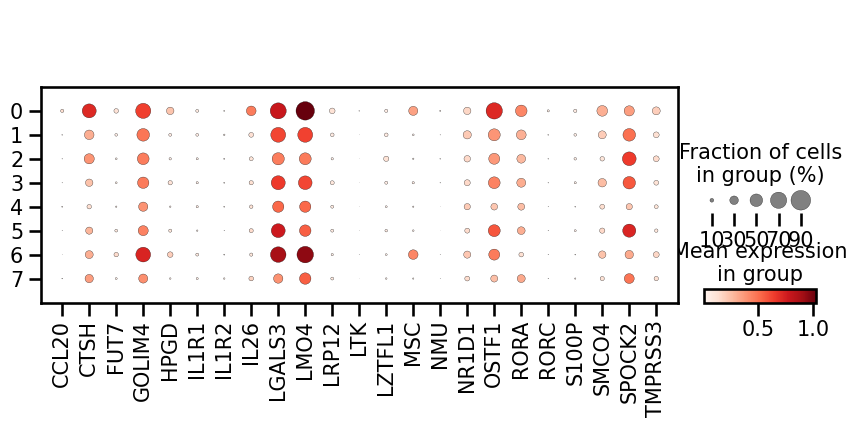

In [184]:
sc.pl.dotplot(ad_stim, program_top_genes['Th17-Activated'], groupby='louvain')

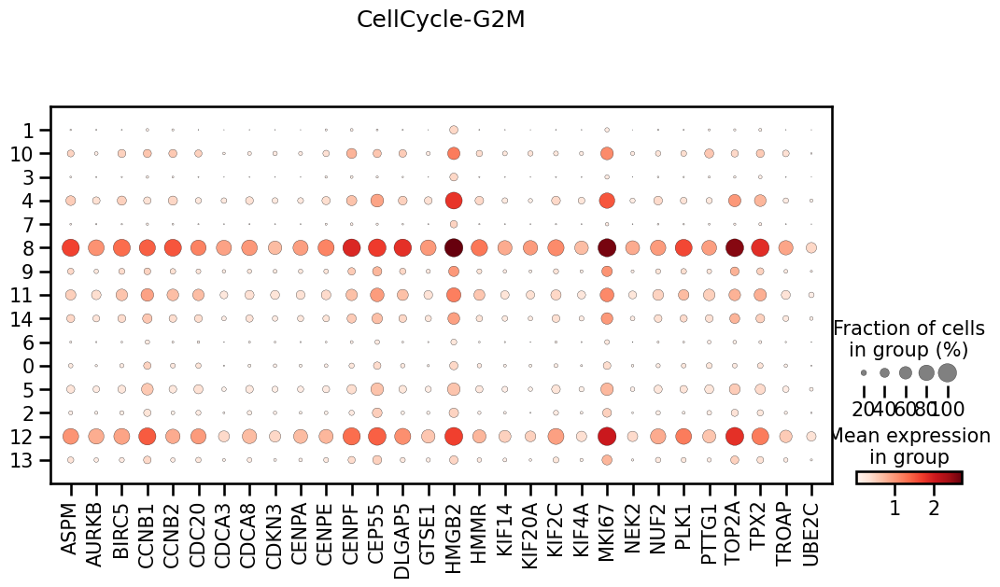

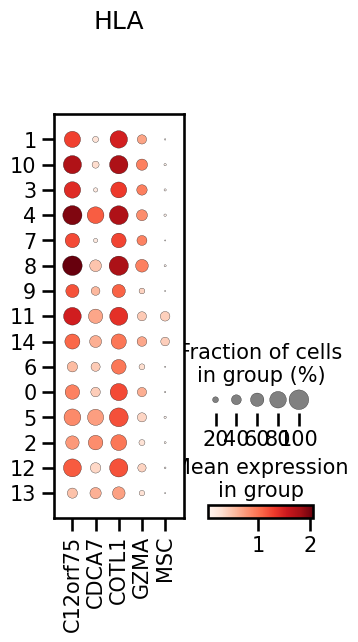

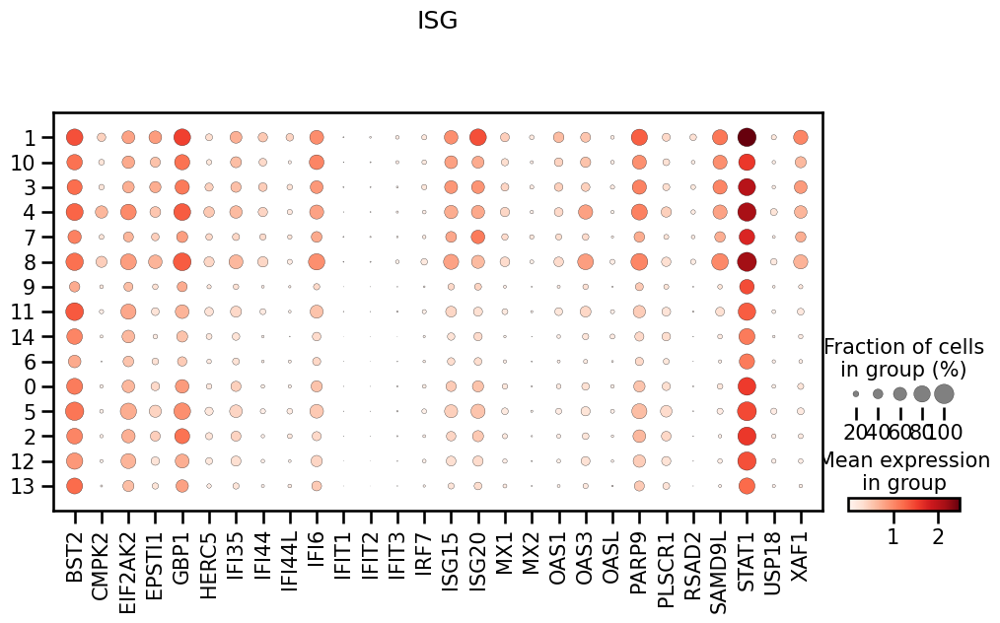

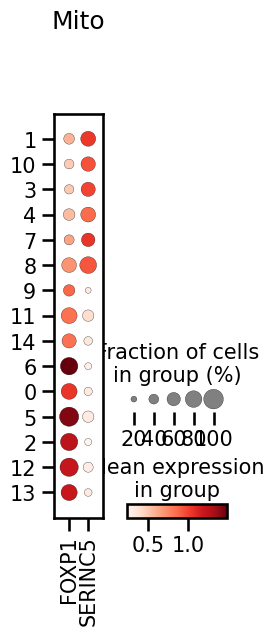

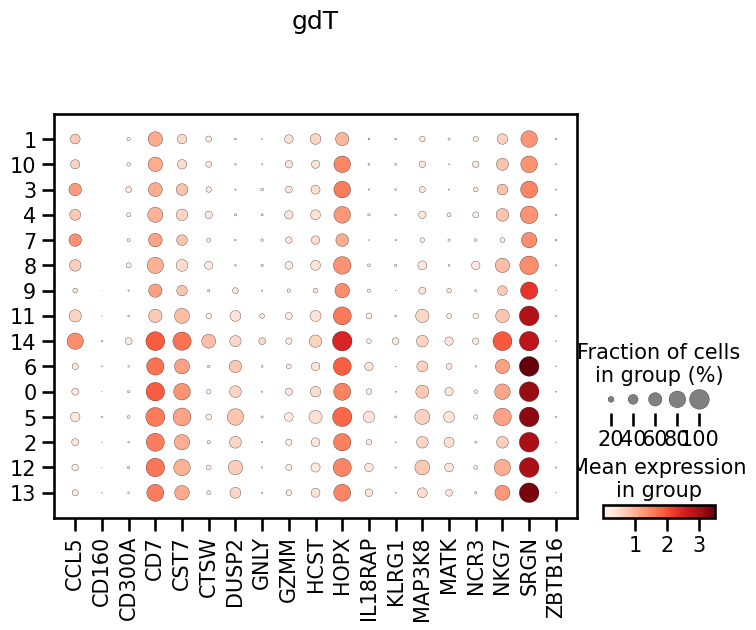

...

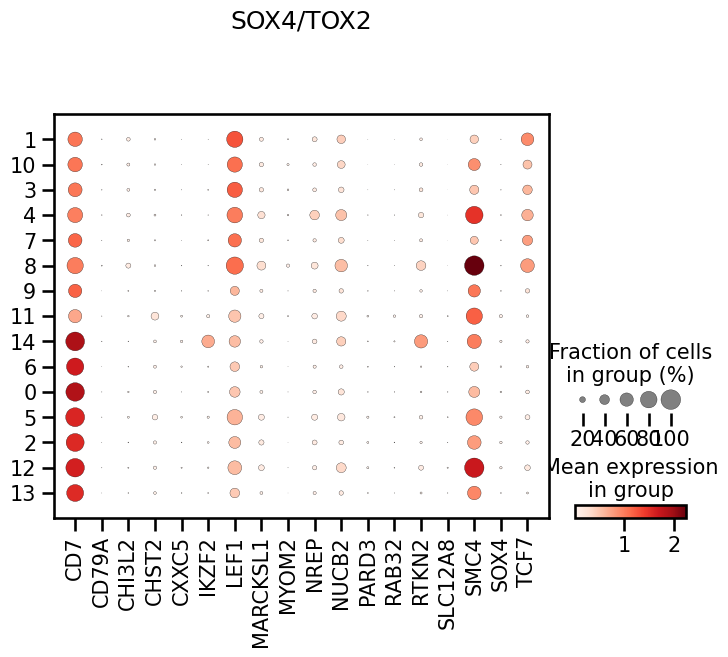

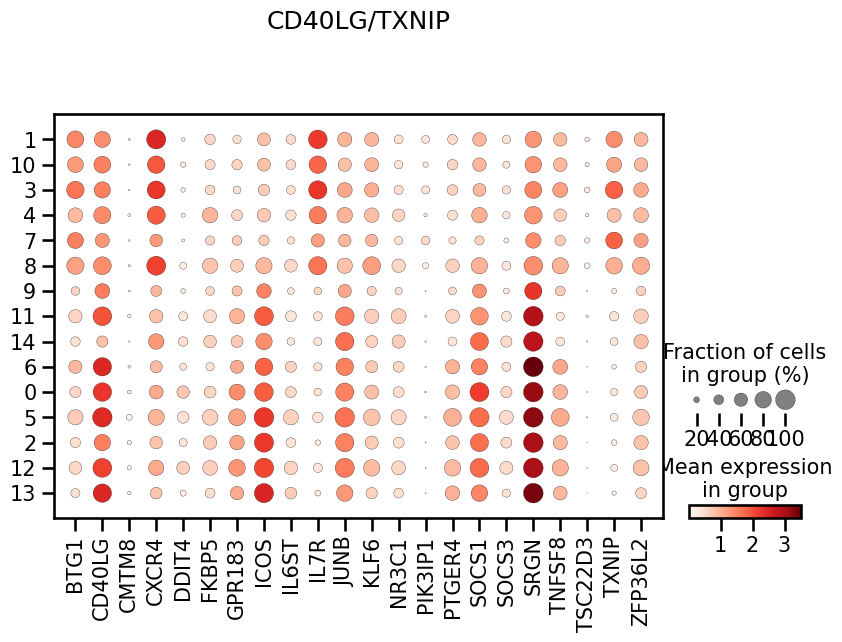

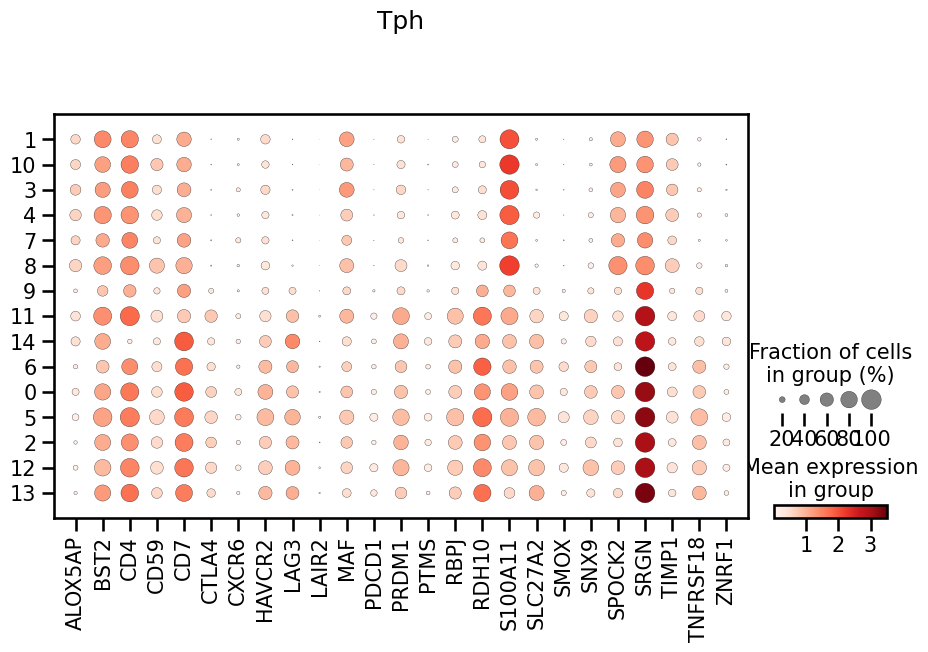

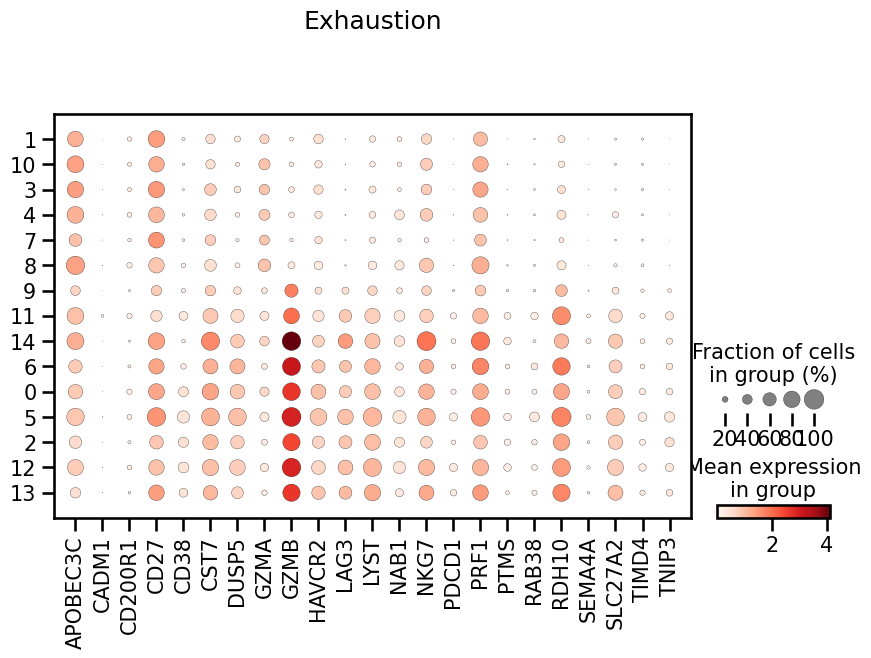

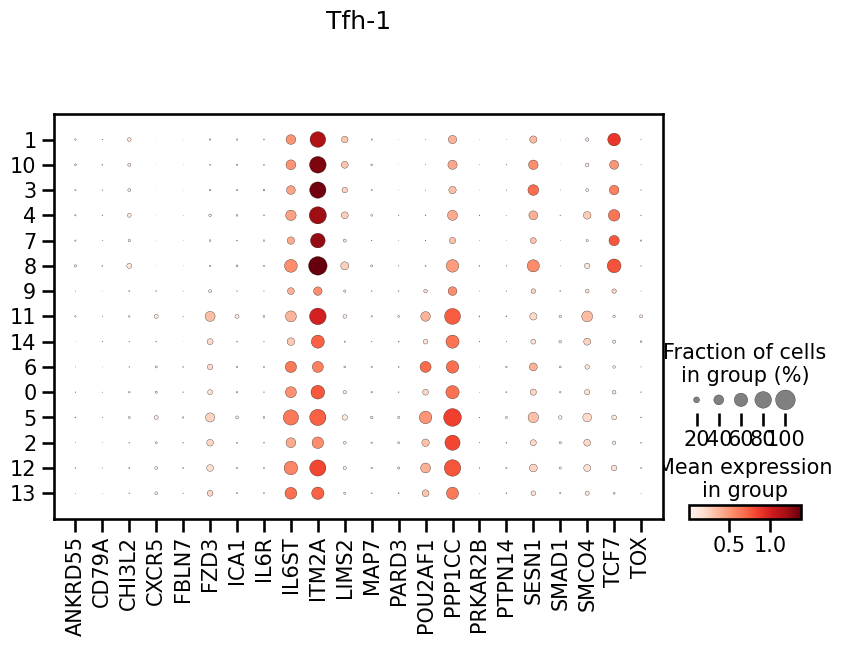

In [140]:
for pr in program_top_genes.keys():
    sc.pl.dotplot(
        mdata_cVI['background'],
        program_top_genes[pr],
        # sc.get.rank_genes_groups_df(mdata_cVI['background'], group='9', log2fc_min=1)[-50:]['names'].tolist(),
        groupby='louvain',
        title=pr
        )
    plt.show()

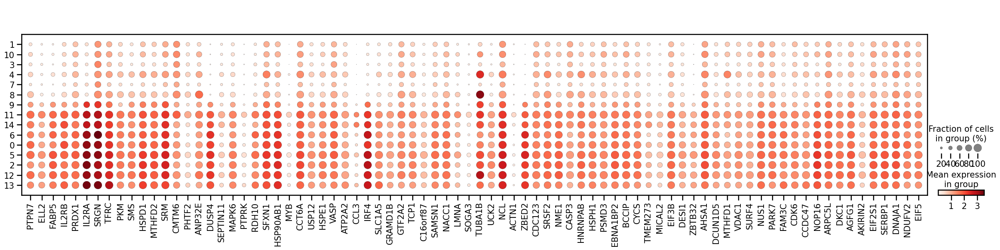

In [82]:
sc.pl.dotplot(
    mdata_cVI['background'],
    sc.get.rank_genes_groups_df(mdata_cVI['background'], group='11', log2fc_min=0)[0:80]['names'].tolist(),
    # sc.get.rank_genes_groups_df(mdata_cVI['background'], group='9', log2fc_min=1)[-50:]['names'].tolist(),
    groupby='louvain'
    )

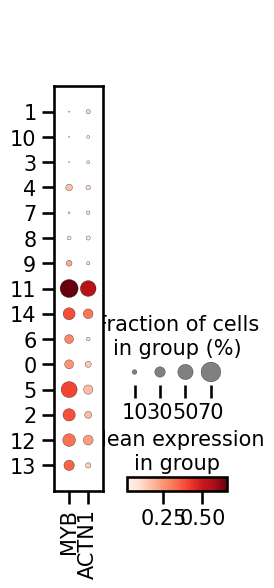

In [85]:
sc.pl.dotplot(
    mdata_cVI['background'],
    ['MYB',  'ACTN1'],
    # sc.get.rank_genes_groups_df(mdata_cVI['background'], group='9', log2fc_min=1)[-50:]['names'].tolist(),
    groupby='louvain'
    )

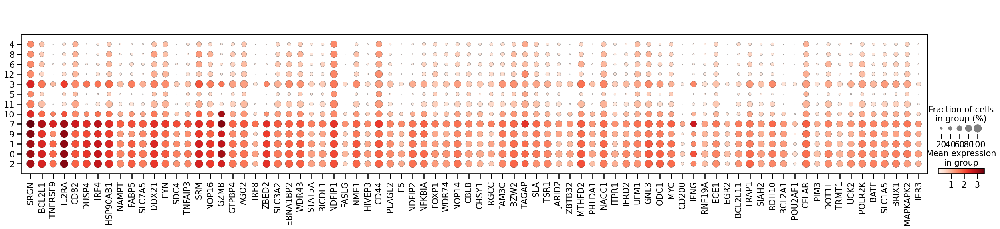

In [139]:
sc.pl.dotplot(
    mdata_cVI['background'],
    sc.get.rank_genes_groups_df(mdata_cVI['background'], group='7', log2fc_min=1)[0:80]['names'].tolist(),
    groupby='louvain'
    )

/tmp/ipykernel_1246159/904547223.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  count_df = perturb_df.groupby(['perturbed_gene_name', 'louvain']).count().reset_index().pivot(index='perturbed_gene_name', columns='louvain', values='culture_condition')


Text(0.5, 1.0, 'Fraction of cells with perturbation')

<Figure size 1200x800 with 0 Axes>

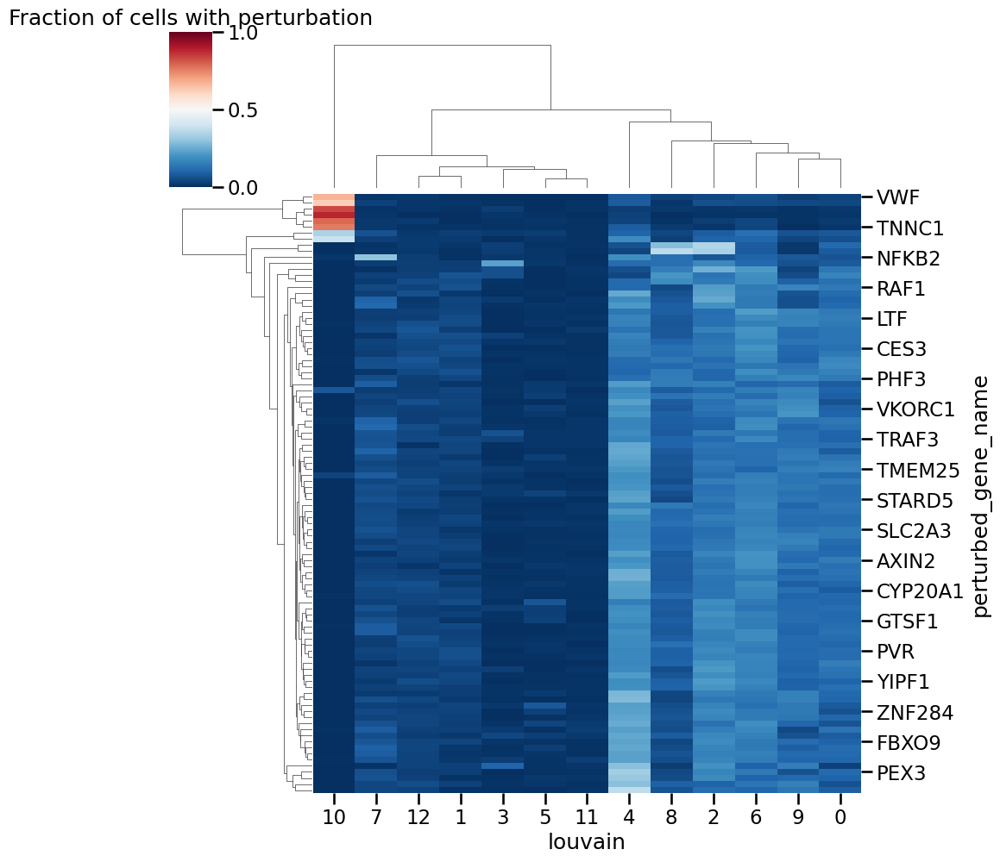

In [115]:
count_df = perturb_df.groupby(['perturbed_gene_name', 'louvain']).count().reset_index().pivot(index='perturbed_gene_name', columns='louvain', values='culture_condition')
top_perturbations = count_df.sum(axis=1).sort_values(ascending=False)[1:100].index

plt.figure(figsize=(12,8))
# Normalize the data to show fractions (percentages) instead of raw counts
normalized_df = count_df.loc[top_perturbations].div(count_df.loc[top_perturbations].sum(axis=1), axis=0)
sns.clustermap(normalized_df, cmap="RdBu_r", vmin=0, vmax=1)
plt.title("Fraction of cells with perturbation")

## Cluster annotation

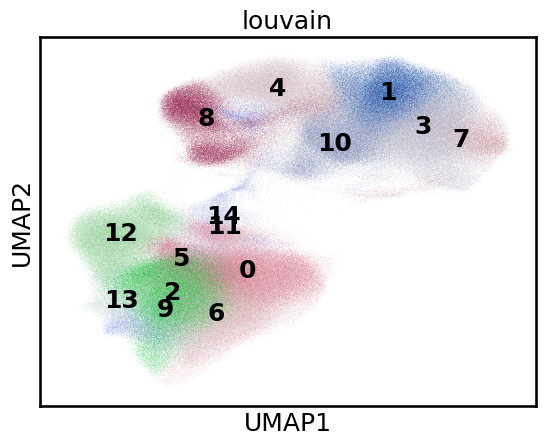

In [141]:
sc.pl.umap(mdata_cVI['background'], color='louvain', legend_loc='on data')

In [145]:
markers_dict['other'] = ['CXCR4',
'TXNIP',
'MSC',
'ACTN1',
'TIGIT',
'MYB',
'PPARG',
'CD9']

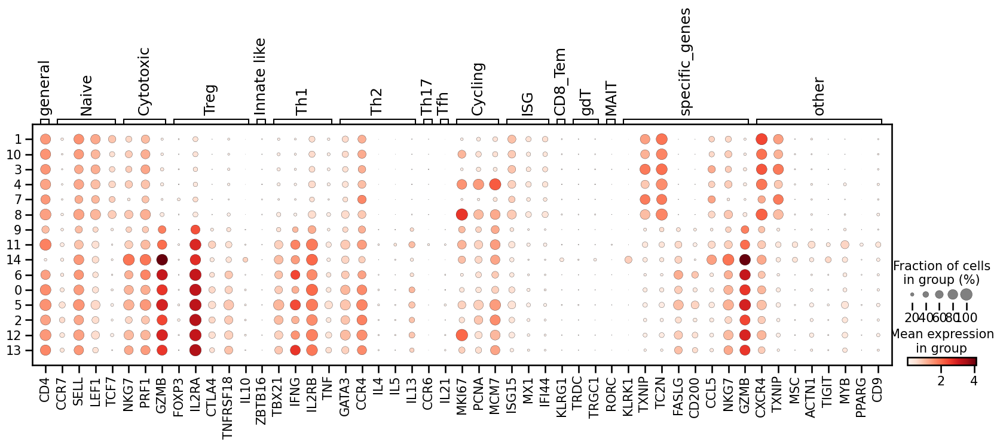

In [146]:
sc.pl.dotplot(mdata_cVI['background'], markers_dict, groupby='louvain')

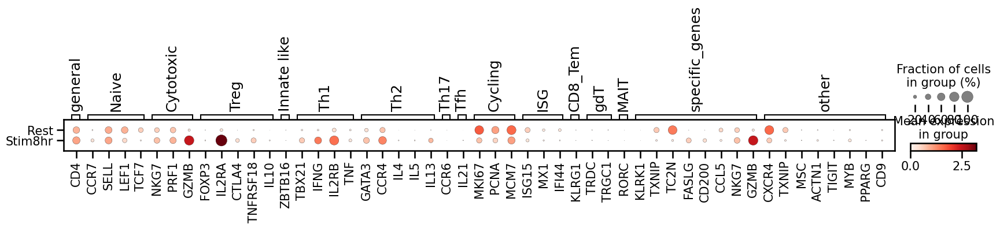

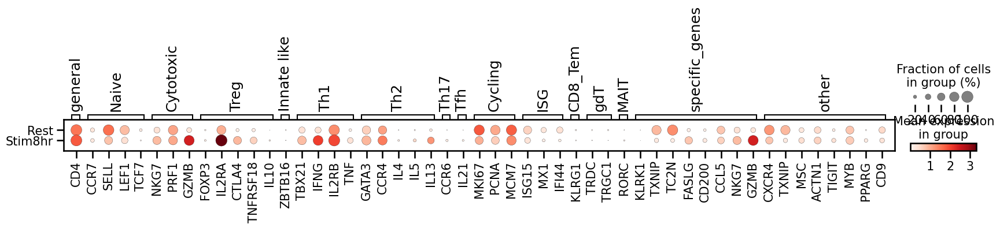

In [156]:
sc.pl.dotplot(mdata_cVI['background'][mdata_cVI['background'].obs['louvain'] == '9'], markers_dict, groupby='culture_condition')
sc.pl.dotplot(mdata_cVI['background'][mdata_cVI['background'].obs['louvain'] == '11'], markers_dict, groupby='culture_condition')

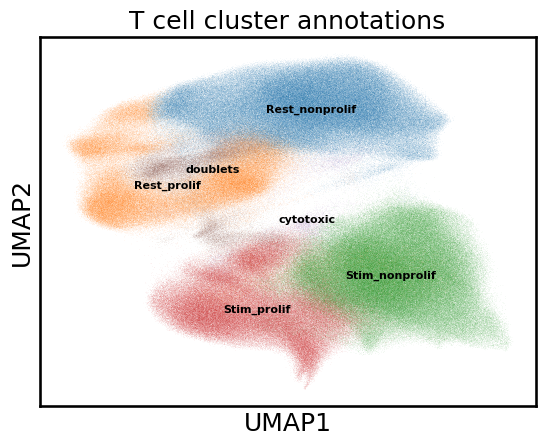

cluster_annotation
Stim_nonprolif    379590
Rest_nonprolif    345853
Stim_prolif       213969
Rest_prolif       192580
doublets           57442
cytotoxic           9732
Name: count, dtype: int64


In [ ]:
# Create a dictionary to assign names to all the louvain clusters based on marker genes
# This will help with biological interpretation of the clusters

# Initialize the cluster annotation dictionary
cluster_annotations = {
    '0': 'Stim_prolif', 
    '1': 'Stim_prolif',  
    '3': 'doublets',  
    '4': 'Rest_nonprolif',  
    '5': 'Rest_nonprolif',  
    '8': 'Rest_nonprolif',  
    '6': 'Rest_prolif',
    '12': 'Rest_prolif'    
    '2': 'Stim_nonprolif', 
    '7': 'Stim_nonprolif_CD200hi', 
    '9': 'Stim_nonprolif', 
    '10': 'cytotoxic', 
    '11': 'doublets',  
}

# Add the annotations to the AnnData object
mdata_cVI['background'].obs['cluster_annotation'] = mdata_cVI['background'].obs['louvain'].astype(str).map(cluster_annotations)

# Plot UMAP with the new annotations
sc.pl.umap(mdata_cVI['background'], color='cluster_annotation', legend_loc='on data', 
           legend_fontsize=8, title='T cell cluster annotations')

# Print the number of cells in each annotated cluster
print(mdata_cVI['background'].obs['cluster_annotation'].value_counts())


In [ ]:
sc.get.obs_df()

## Test for perturbation specific neighbourhoods

In [8]:
import pertpy

In [50]:
milo = pertpy.tl.Milo()
mdata = milo.load(mdata_cVI['background'])
milo.make_nhoods(mdata["rna"], prop=0.01)

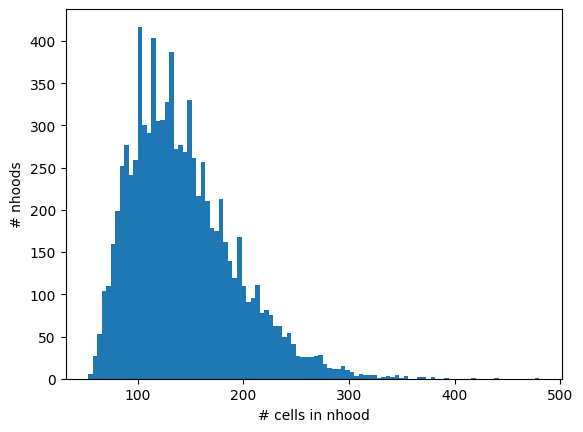

In [51]:
nhood_size = np.array(mdata["rna"].obsm["nhoods"].sum(0)).ravel()
plt.hist(nhood_size, bins=100)
plt.xlabel("# cells in nhood")
plt.ylabel("# nhoods");

In [11]:
# Convert guide_id to 3 categories: non-targeting, targeting, and multi_sgRNA
guide_types = []
for guide_id in mdata['rna'].obs['guide_id']:
    if pd.isna(guide_id):
        guide_types.append('NTC')
    elif str(guide_id).startswith('NTC'):
        guide_types.append('NTC')
    elif guide_id == 'multi_sgRNA':
        guide_types.append('multi_sgRNA')
    else:
        guide_types.append('targeting')

# Add the new categorized guide_type to the observation dataframe
mdata['rna'].obs['guide_type'] = guide_types
mdata['rna'].obs['guide_type'] = mdata['rna'].obs['guide_type'].astype('category')

# Display the distribution of guide types
print(mdata['rna'].obs['guide_type'].value_counts())

guide_type
targeting    889631
NTC           39459
Name: count, dtype: int64


In [12]:
mdata['rna'].obs['sample_id'] = mdata['rna'].obs['cell_sample_id'].astype(str) + '-' + mdata['rna'].obs['lane_id'].astype(str) + '-' + mdata['rna'].obs['guide_type'].astype(str)
mdata = milo.count_nhoods(mdata, sample_col="sample_id")

In [18]:
milo.da_nhoods(mdata, design="~guide_type", model_contrasts='guide_typetargeting-guide_typeNTC')

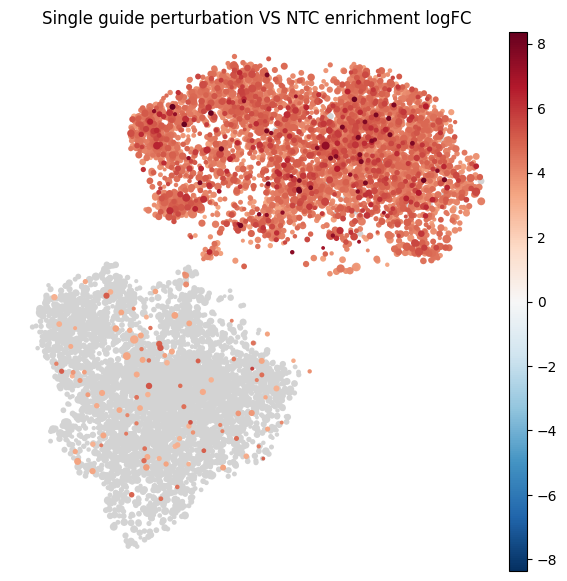

In [19]:
milo.build_nhood_graph(mdata)
plt.rcParams["figure.figsize"] = [7, 7]
milo.plot_nhood_graph(
    mdata,
    alpha=0.1,  ## SpatialFDR level (1%)
    min_size=0.5,  ## Size of smallest dot
    title='Single guide perturbation VS NTC enrichment logFC'
)


In [12]:
mdata['rna'].obs['sample_id'] = mdata['rna'].obs['cell_sample_id'].astype(str) + '-' + mdata['rna'].obs['perturbed_gene_name'].astype(str)
# mdata = milo.count_nhoods(mdata, sample_col="sample_id")

In [52]:
# # Exclude cells in no neighbourhood
# nh_mask = np.array(mdata['rna'].obsm['nhoods'].sum(1)).flatten() > 0

# Exclude perturbations with kew cells
gene_counts = mdata['rna'].obs['perturbed_gene_name'].value_counts() 
keep_kds = gene_counts[gene_counts > 30].index
kd_mask = mdata['rna'].obs['perturbed_gene_name'].isin(keep_kds)

mdata.mod['rna'] = mdata['rna'][kd_mask]

In [53]:
mdata['rna']

View of AnnData object with n_obs × n_vars = 882808 × 5000
    obs: 'library_id', 'lane_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'batch', 'cell_sample_id', 'donor_id', 'culture_condition', 'top_guide_UMI_counts', 'guide_id', 'perturbed_gene_name', 'perturbed_gene_id', 'guide_type', 'low_quality', 'louvain', 'QC_mask', '_scvi_batch', '_scvi_labels', 'nhood_ixs_random', 'nhood_ixs_refined', 'nhood_kth_distance', 'sample_id'
    var: 'gene_ids', 'gene_name', 'mt'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'neighbors', 'umap', 'nhood_neighbors_key'
    obsm: 'X_umap', 'contrastiveVI_background', 'contrastiveVI_salient', 'nhoods'
    obsp: 'connectivities', 'distances'

In [58]:
from scipy.sparse import csr_matrix
adata = mdata['rna']
sample_col = 'perturbed_gene_name'

nhoods = adata.obsm["nhoods"]
# Make nhood abundance matrix
sample_dummies = pd.get_dummies(adata.obs[sample_col])
all_samples = sample_dummies.columns
sample_dummies = csr_matrix(sample_dummies.values)
nhood_count_mat = nhoods.T.dot(sample_dummies)
sample_obs = pd.DataFrame(index=all_samples)

NameError: name 'AnnData' is not defined

In [63]:
sample_adata = anndata.AnnData(X=nhood_count_mat.T, obs=sample_obs)
sample_adata.uns["sample_col"] = sample_col
sc.pp.normalize_total(sample_adata, target_sum=10000)
sc.pp.log1p(sample_adata)

In [64]:
sc.pp.pca(sample_adata)

In [91]:
sc.get.obs_df(sample_adata, obsm_keys=[('X_pca', i) for i in range(20)]).sort_values('X_pca-1')

,X_pca-0,X_pca-1,X_pca-2,X_pca-3,X_pca-4,X_pca-5,X_pca-6,X_pca-7,X_pca-8,X_pca-9,X_pca-10,X_pca-11,X_pca-12,X_pca-13,X_pca-14,X_pca-15,X_pca-16,X_pca-17,X_pca-18,X_pca-19
BCL9,17.402573,-17.215723,-1.536951,-3.784190,10.897717,0.475751,4.900828,-3.658817,2.404794,6.165363,-4.673052,-5.935385,-3.922087,4.127024,1.256390,5.298058,3.695587,0.577219,8.023036,2.216021
NEURL1,10.292346,-15.547008,6.856522,-3.878788,7.765156,1.821567,0.129197,-2.810564,-6.387018,7.859284,-3.260410,-7.981164,-3.721615,0.753139,1.740045,-0.291471,-0.819808,3.703011,1.010816,-1.823015
ZNF556,10.143103,-13.461245,7.220662,-3.751338,5.141016,-0.633637,2.441109,-2.595684,-6.226192,6.160671,-4.829513,-4.748859,0.377287,1.408440,-1.780763,-3.571104,0.386299,0.364146,-4.138222,-0.868680
SETDB1,12.959234,-11.881523,6.340024,-1.113751,0.743155,-4.882622,8.089839,1.340492,-7.132449,0.971707,3.825601,1.761221,-5.448702,-0.109338,0.837209,1.450982,-6.538326,8.154050,-6.452277,6.184509
HINT2,8.788293,-11.808231,3.844478,-5.318205,8.920631,-2.927964,2.885333,-4.207798,-2.891161,5.299578,-2.018027,-2.050144,-1.426763,2.141766,1.412320,1.647457,0.691774,-2.077371,0.989202,-3.200993
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SYT11,23.866632,17.449697,-12.515722,1.959210,0.970896,4.359663,-1.385737,-1.443413,-3.233232,3.075440,-3.718948,-5.543044,-1.695774,-6.579053,0.336142,0.936647,3.815731,3.358541,-3.869119,1.585131
CALCOCO1,22.000969,18.063349,1.742700,-1.838097,2.277178,9.753557,-2.984822,-0.465588,-6.546132,-2.828991,3.883790,-3.676589,-0.689898,-6.942625,3.463068,3.161019,3.130687,-0.486148,0.009003,2.304674
CES3,21.618385,18.118834,-14.319125,2.082443,3.885422,-0.811820,-1.635147,1.326525,-6.485075,1.321259,-5.352435,-1.618370,1.466133,-3.482258,-0.305793,1.462994,-1.889971,1.751422,-3.289985,2.203179
ACSL5,16.007746,18.592066,3.969946,-2.017326,-0.754814,11.002623,6.088376,1.997086,-7.672360,-1.391559,7.091750,-0.482687,-0.984139,-6.027126,2.301531,4.021290,4.965937,-3.816507,-0.545814,0.197042


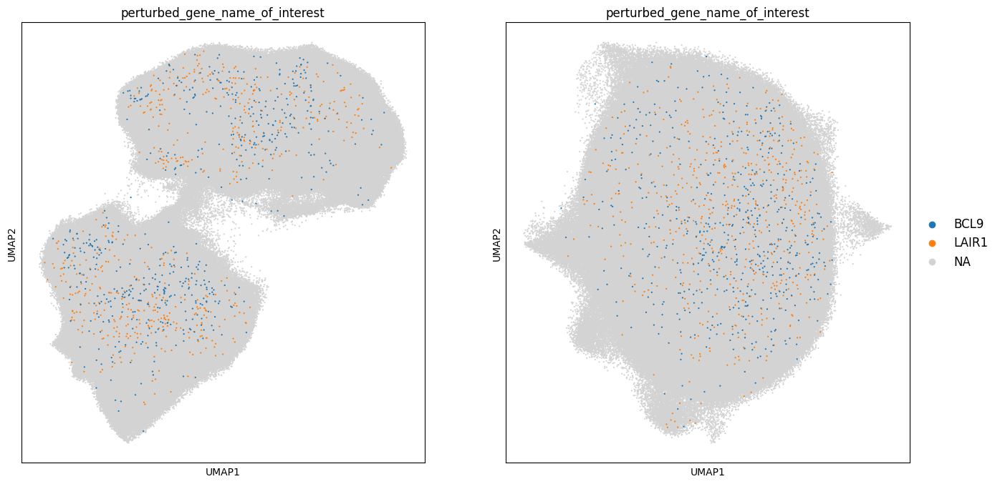

In [96]:
d = 'X_pca-1'
# group_oi = sc.get.obs_df(sample_adata, obsm_keys=[('X_pca', i) for i in range(20)]).sort_values(d)[d][0:10].index.tolist()
group_oi = ['LAIR1', 'BCL9']

mdata_cVI['background'].obs['perturbed_gene_name_of_interest'] = np.where(mdata_cVI['background'].obs['perturbed_gene_name'].isin(group_oi), mdata_cVI['background'].obs['perturbed_gene_name'], np.nan)
# del mdata_cVI['background'].uns['perturbed_gene_name_of_interest_colors']
mdata_cVI['salient'].obs['perturbed_gene_name_of_interest'] = np.where(mdata_cVI['salient'].obs['perturbed_gene_name'].isin(group_oi), mdata_cVI['salient'].obs['perturbed_gene_name'], np.nan)
# del mdata_cVI['salient'].uns['perturbed_gene_name_of_interest_colors']

fig = plt.figure(figsize=(16,8))
ax = fig.add_subplot(1, 2, 1)
sc.pl.umap(mdata_cVI['background'], color='perturbed_gene_name_of_interest', legend_loc=None, size=10, show=False, ax=ax)
ax = fig.add_subplot(1, 2, 2)
sc.pl.umap(mdata_cVI['salient'], color='perturbed_gene_name_of_interest', legend_fontsize=12, size=10, show=False, ax=ax)
plt.show()

In [139]:
milo.annotate_nhoods(mdata, anno_col="guide_id")

In [180]:
milo.annotate_nhoods_continuous(mdata, anno_col="top_guide_UMI_counts")

In [169]:
mdata['milo'].var['nhood_annotation'] = np.where(mdata['milo'].var['nhood_annotation_frac'] < 0.5, 'Mixed', mdata['milo'].var['nhood_annotation'])

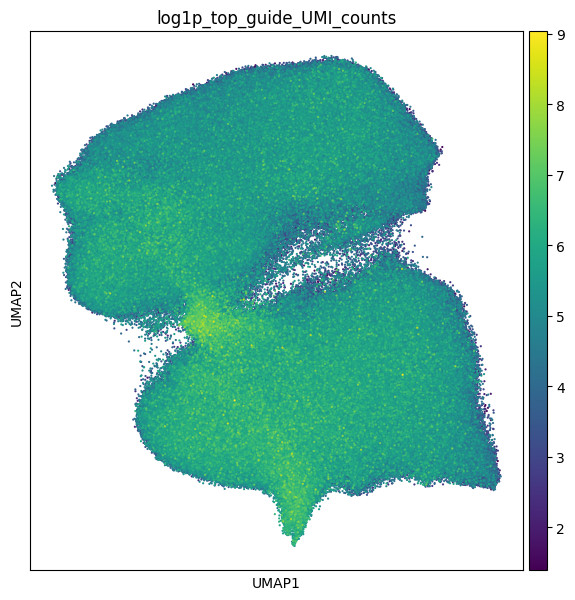

In [186]:
mdata_cVI['background'].obs['log1p_top_guide_UMI_counts'] = np.where(mdata_cVI['background'].obs['top_guide_UMI_counts'].isna(), np.nan, np.log1p(mdata_cVI['background'].obs['top_guide_UMI_counts']))
sc.pl.umap(mdata_cVI['background'], color='log1p_top_guide_UMI_counts', size=10)

<Axes: xlabel='logFC', ylabel='nhood_top_guide_UMI_counts'>

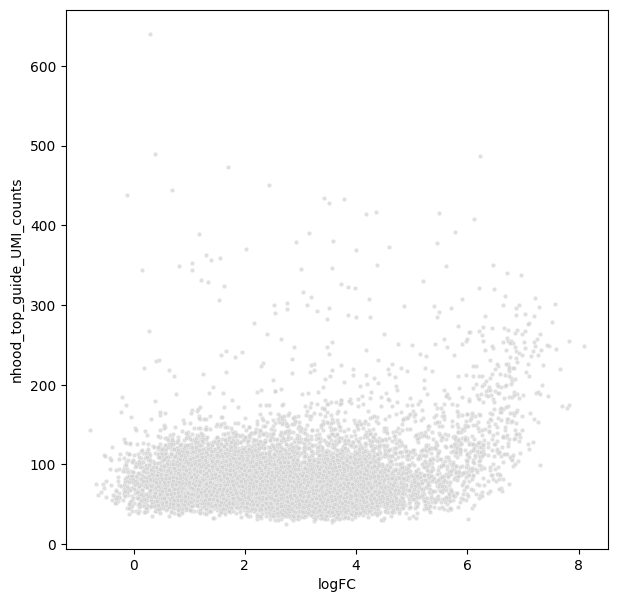

In [181]:
sns.scatterplot(x=mdata['milo'].var['logFC'], y=mdata['milo'].var['nhood_top_guide_UMI_counts'], color='lightgrey', alpha=0.7, s=10)

<Axes: xlabel='logFC', ylabel='SpatialFDR'>

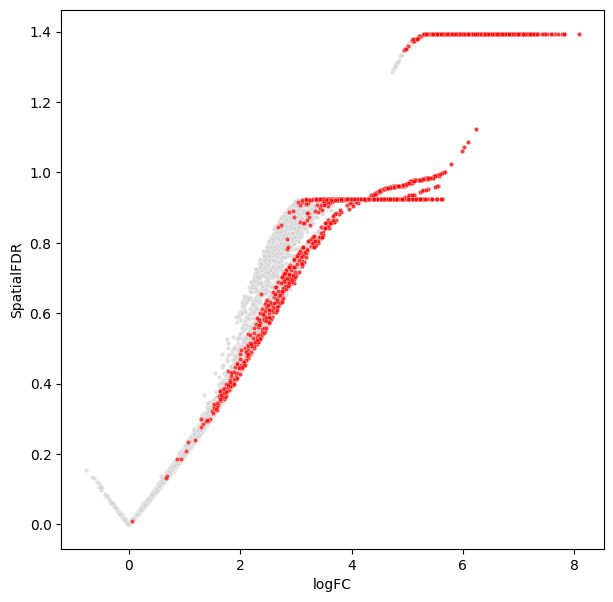

In [178]:
# First plot all points as grey dots
sns.scatterplot(x=mdata['milo'].var['logFC'], y=-np.log10(mdata["milo"].var.SpatialFDR), color='lightgrey', alpha=0.7, s=10)
sns.scatterplot(x=mdata['milo'].var[multi_sgRNA_mask]['logFC'], y=-np.log10(mdata["milo"].var[multi_sgRNA_mask].SpatialFDR), color='red', alpha=0.7, s=10)

# # Then overlay red points where nhood_annotation is 'multi_sgRNA'
# multi_sgRNA_mask = mdata['milo'].var['nhood_annotation'] == 'multi_sgRNA'
# sns.scatterplot(data=mdata['milo'].var[multi_sgRNA_mask], x='logFC', y='nhood_annotation_frac', color='red')

In [190]:
signif_ixs = mdata['milo'].var_names[mdata['milo'].var['SpatialFDR'] < 0.05]
perturb_anno_signif = mdata['milo'].varm['frac_annotation']
perturb_anno_signif[np.isnan(perturb_anno_signif)] = 0
perturb_anno_signif = pd.DataFrame(perturb_anno_signif, columns=mdata['milo'].uns['annotation_labels'], index=mdata['milo'].var_names)
perturb_anno_signif['nhood_top_guide_UMI_counts'] = mdata['milo'].var['nhood_top_guide_UMI_counts'] 

<Axes: xlabel='is_signif', ylabel='nhood_top_guide_UMI_counts'>

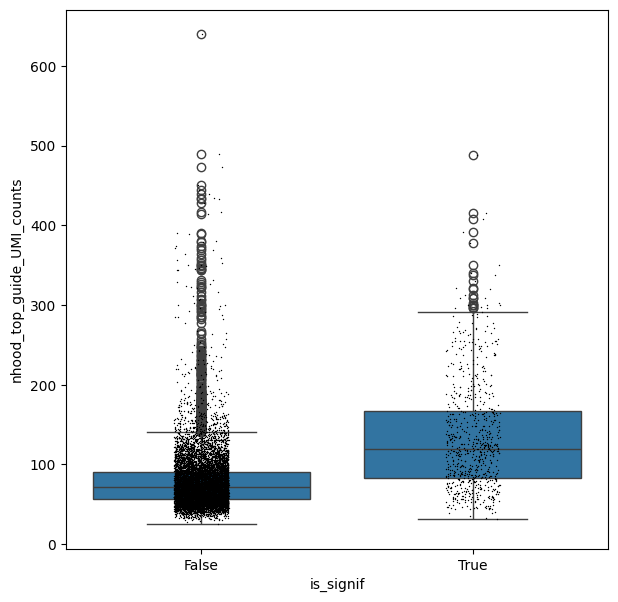

In [191]:
perturb_anno_signif['is_signif'] = perturb_anno_signif.index.isin(signif_ixs)
sns.boxplot(data=perturb_anno_signif, x='is_signif', y = 'nhood_top_guide_UMI_counts')
sns.stripplot(data=perturb_anno_signif, x='is_signif', y = 'nhood_top_guide_UMI_counts', color='black', size=1)

<Axes: xlabel='is_signif', ylabel='multi_sgRNA'>

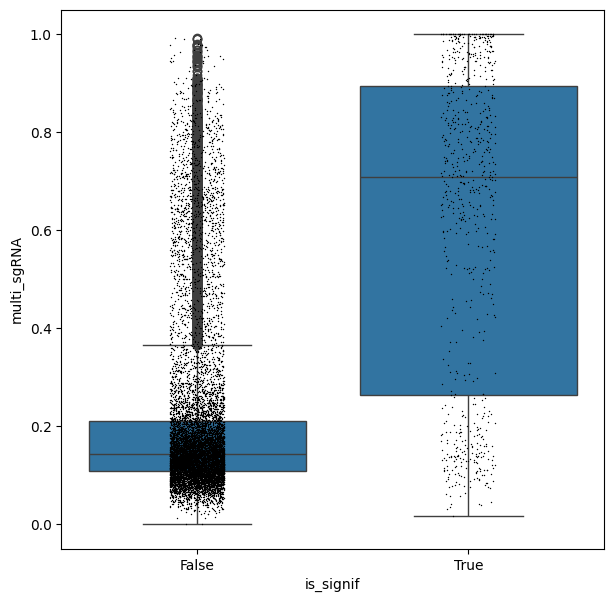

In [158]:
perturb_anno_signif['is_signif'] = perturb_anno_signif.index.isin(signif_ixs)
sns.boxplot(data=perturb_anno_signif, x='is_signif', y = 'multi_sgRNA')
sns.stripplot(data=perturb_anno_signif, x='is_signif', y = 'multi_sgRNA', color='black', size=1)

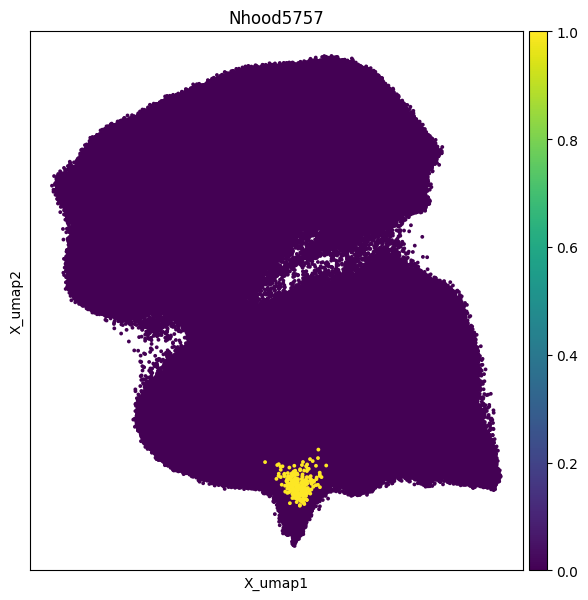

In [113]:
milo.plot_nhood(mdata, ix=5757)

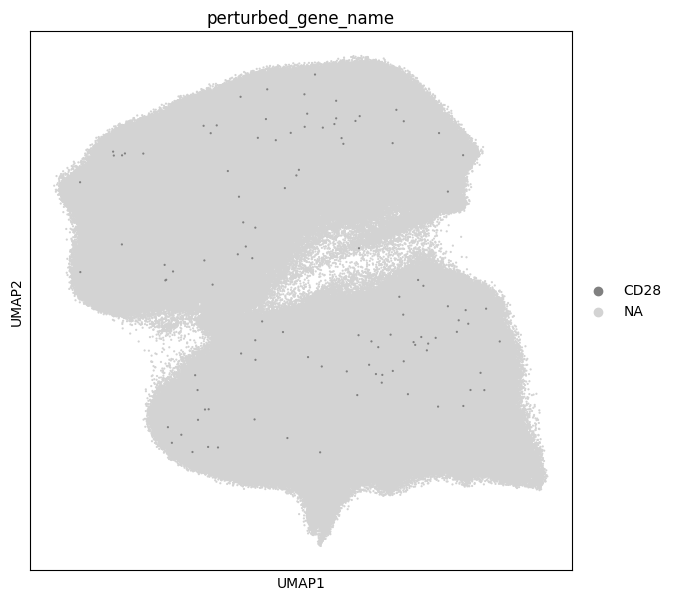

In [202]:
sc.pl.umap(mdata_cVI['background'], color='perturbed_gene_name', groups=['CD28'], size=10)

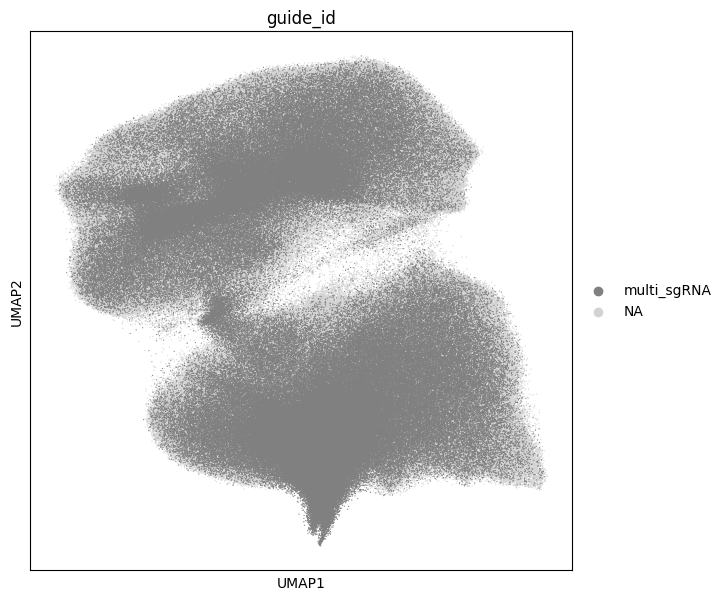

In [146]:
sc.pl.umap(mdata_cVI['background'], color='guide_id', groups=['multi_sgRNA'], size=3)

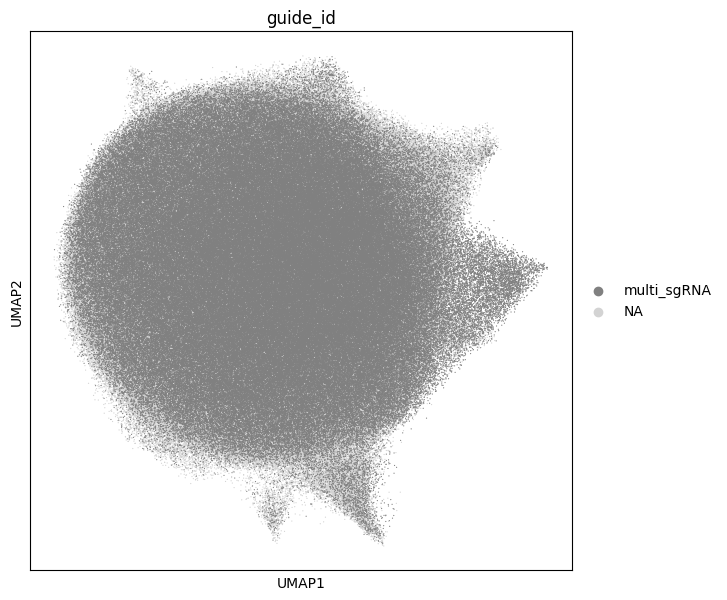

In [203]:
sc.pl.umap(mdata_cVI['salient'], color='guide_id', groups=['multi_sgRNA'], size=3)

In [197]:
sc.pl.umap(adata, color='perturbed_gene_name')

CCGCTAAGTATTGACCAGTAGGCT-1_lane13_CRiCD4IL2D1_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
GTACGCAAGGTTGTGGAGTAGGCT-1_lane13_CRiCD4IL2D1_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
CATAGCGAGGATCCCTATCCCAAC-1_lane13_CRiCD4IL2D2_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
CGTACGTTCATAACCTAGCTGTGA-1_lane13_CRiCD4IL2D2_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
CTCGCTTGTACTTCAAAAGTAGAG-1_lane13_CRiCD4IL2D2_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
CTGGTGAAGGGCCTTTAAGTAGAG-1_lane13_CRiCD4IL2D2_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
TAGAAAGCATATTTCGAGCTGTGA-1_lane13_CRiCD4IL2D2_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
TGCAGCAAGCAATTGAATCCCAAC-1_lane13_CRiCD4IL2D2_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
TTCGGTCAGCGCAAGCAAGTAGAG-1_lane13_CRiCD4IL2D2_Rest_CRiCD4IL2_Run1_Illumina       IL2RA
GAGCTTTGTTGGAGCGACAGTCTG-1_lane13_CRiCD4IL2D1_Stim8hr_CRiCD4IL2_Run1_Illumina    IL2RA
GGGATTTAGGTGAGGGAGAGGCAA-1_lane13_CRiCD4IL2D1_Stim8hr_CRiCD4IL2_Run1_Illumina    IL2RA
TGGTTTGTCCCTCGTCAGAGGCAA-1_lane13_CRiCD4IL2

### Test for multi-sgRNA

In [205]:
mdata['rna'].obs['is_multi_sgrna'] = np.where(mdata['rna'].obs['guide_id'] == 'multi_sgRNA', 'multi', 'single')

In [206]:
mdata['rna'].obs['sample_id'] = mdata['rna'].obs['cell_sample_id'].astype(str) + '-' + mdata['rna'].obs['lane_id'].astype(str) + '-' + mdata['rna'].obs['is_multi_sgrna'].astype(str)

In [207]:
mdata = milo.count_nhoods(mdata, sample_col="sample_id")

In [208]:
milo.da_nhoods(mdata, design="~is_multi_sgrna")

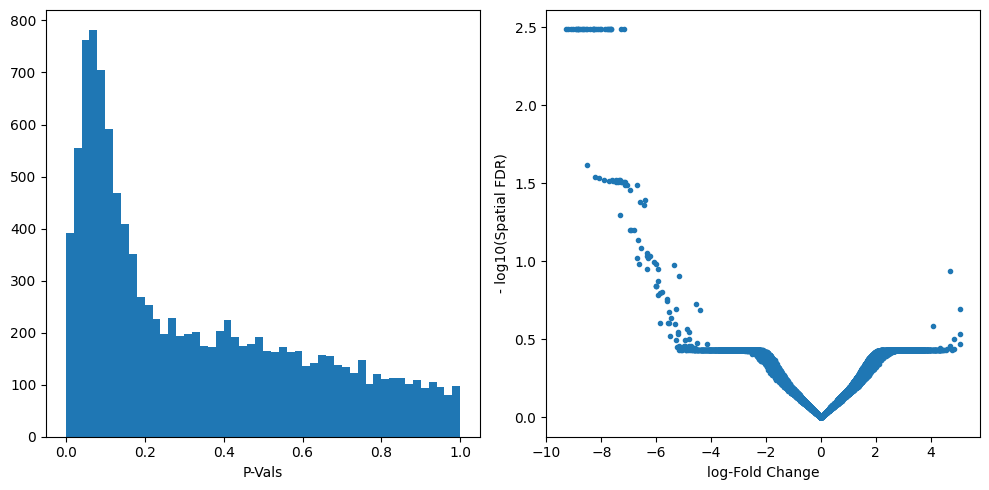

In [209]:
old_figsize = plt.rcParams["figure.figsize"]
plt.rcParams["figure.figsize"] = [10, 5]
plt.subplot(1, 2, 1)
plt.hist(mdata["milo"].var.PValue, bins=50)
plt.xlabel("P-Vals")
plt.subplot(1, 2, 2)
plt.plot(mdata["milo"].var.logFC, -np.log10(mdata["milo"].var.SpatialFDR), ".")
plt.xlabel("log-Fold Change")
plt.ylabel("- log10(Spatial FDR)")
plt.tight_layout()
plt.rcParams["figure.figsize"] = old_figsize

/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/anndata/_core/anndata.py:1155: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


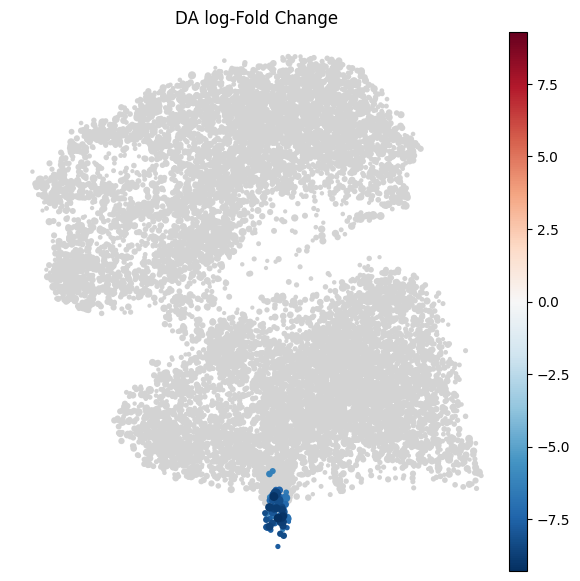

In [219]:
milo.build_nhood_graph(mdata)
plt.rcParams["figure.figsize"] = [7, 7]
milo.plot_nhood_graph(
    mdata,
    alpha=0.1,  ## SpatialFDR level (1%)
    min_size=0.5,  ## Size of smallest dot
)

In [127]:
perturb_anno_signif.loc['5757'].sort_values()

A1BG      0.0
RAB23     0.0
RAB24     0.0
RAB27A    0.0
RAB27B    0.0
         ... 
GPR63     0.0
GPR65     0.0
GPR75     0.0
ZZEF1     0.0
ANK1      1.0
Name: 5757, Length: 12107, dtype: float32

/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/emmadann/miniforge3/envs/rpy2-voodoo/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


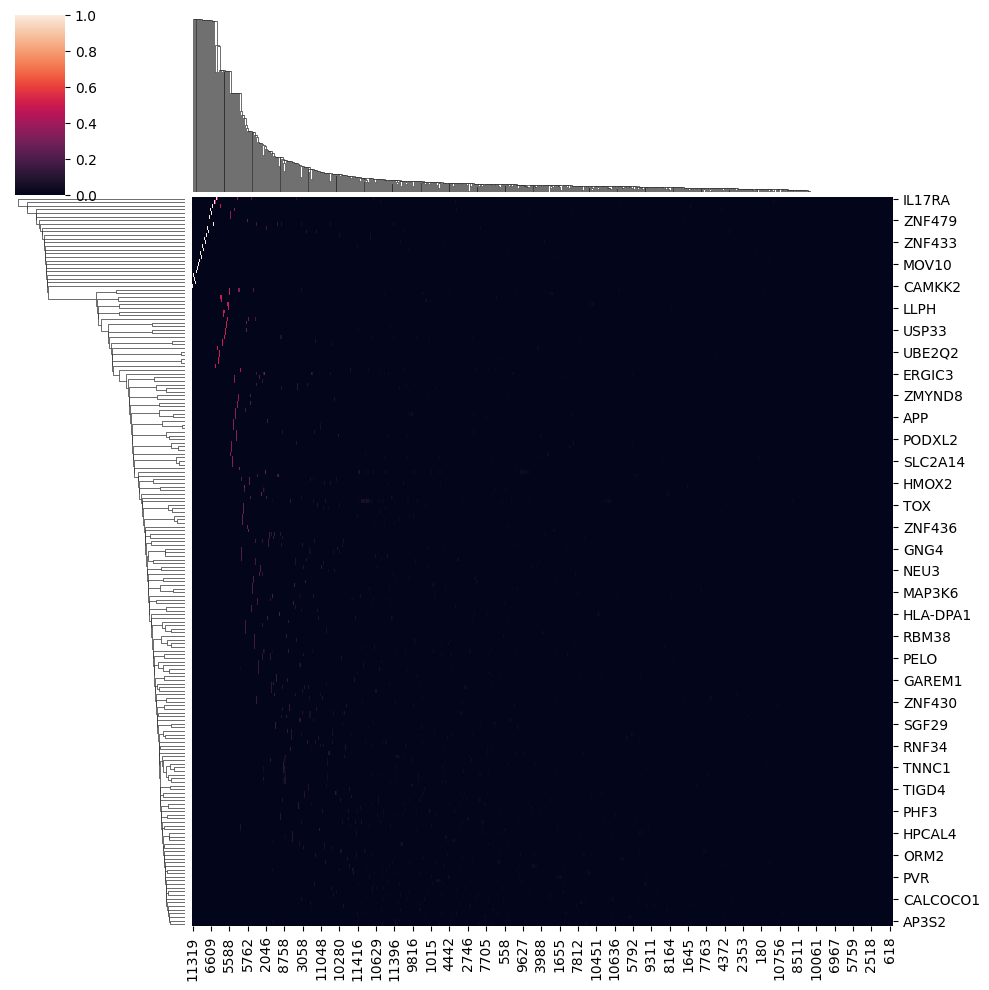

In [91]:
sns.clustermap(perturb_anno_signif[perturb_anno_signif.sum().sort_values(ascending=False)[0:200].index].T)

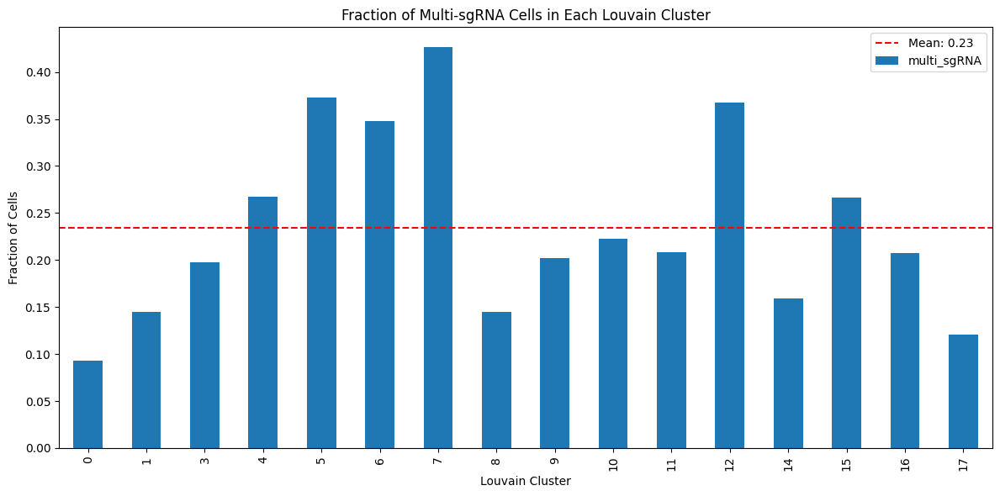

In [221]:
# Calculate the count of cells by louvain cluster and guide_type
counts = mdata_cVI['background'].obs[['louvain', 'guide_id']].groupby(['louvain', 'guide_id']).size().unstack(fill_value=0)

# Calculate the fraction of each guide_type within each louvain cluster
fractions = counts.div(counts.sum(axis=1), axis=0)

# Extract only the multi_sgRNA guide fraction
multi_sgRNA_fraction = fractions['multi_sgRNA']

# Plot the multi_sgRNA fraction as a bar chart
ax = multi_sgRNA_fraction.plot(kind='bar', figsize=(12, 6))
ax.set_xlabel('Louvain Cluster')
ax.set_ylabel('Fraction of Cells')
ax.set_title('Fraction of Multi-sgRNA Cells in Each Louvain Cluster')
plt.axhline(y=multi_sgRNA_fraction.mean(), color='r', linestyle='--', label=f'Mean: {multi_sgRNA_fraction.mean():.2f}')
plt.legend()
plt.tight_layout()
plt.show()